In [2]:
# Importing packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import xarray as xr
import cartopy.crs as ccrs
from matplotlib import gridspec
import matplotlib
from scipy.optimize import curve_fit
import warnings
from scipy.optimize import OptimizeWarning

In [5]:
# Loading data
dataarray_SST_cont = xr.open_dataarray('/data/keeling/a/mailes2/a/processed_var_data/CMIP_sst_piControl_interp_2x2_15memens_3.nc')
dataarray_SST_cont.load()

dataarray_Qo_cont = xr.open_dataarray('/data/keeling/a/mailes2/a/processed_var_data/CMIP_ocean_piControl_2x2_15memens_2.nc')
dataarray_Qo_cont.load()

dataarray_Qs_cont = xr.open_dataarray('/data/keeling/a/mailes2/a/processed_var_data/CMIP_surface_piControl_2x2_15memens_2.nc')
dataarray_Qs_cont.load()

mlotst = xr.open_dataarray('/data/keeling/a/mailes2/a/processed_var_data/CMIP_mlotst_piControl_2x2_15memens.nc')
mlotst.load()

#coeffs = xr.open_dataarray('/data/keeling/a/mailes2/a/processed_var_data/CMIP_regress_coeffs.nc')
#coeffs.load()

vert_ds = xr.open_dataarray('/data/keeling/a/mailes2/cesmle_variability_analysis/processed_data/vert_ds.nc')
vert_ds.load()

<xarray.DataArray 'wap' (lat: 88, lon: 179)>
array([[ 9.05317347e-03,  5.35726221e-03,  3.90954921e-03, ...,
         1.37608778e-02,  1.27784014e-02,  1.16651980e-02],
       [ 1.62603296e-02,  1.84076093e-02,  1.68463495e-02, ...,
         2.34749150e-02,  2.32172329e-02,  2.24996507e-02],
       [ 1.72343142e-02,  1.73817184e-02,  1.67526975e-02, ...,
         1.50780585e-02,  1.46754114e-02,  1.46230198e-02],
       ...,
       [-2.22924957e-03, -1.80104235e-03, -1.62051118e-03, ...,
        -1.75005000e-03, -2.10483326e-03, -2.04990618e-03],
       [-6.93217677e-04, -1.27934688e-03, -1.30213355e-03, ...,
        -7.43095938e-04, -8.93206510e-04, -9.83634265e-04],
       [ 4.50923544e-04, -8.85086847e-05,  6.49775393e-05, ...,
        -5.63950336e-04, -4.56162205e-04, -3.77876189e-04]], dtype=float32)
Coordinates:
    plev     float64 5e+04
  * lat      (lat) int64 -87 -85 -83 -81 -79 -77 -75 ... 75 77 79 81 83 85 87
  * lon      (lon) int64 1 3 5 7 9 11 13 15 ... 343 345 347 349 351 353 355 357

In [3]:
# Loading coefficient matrices

coeffs_canesm_4x4 = xr.open_dataarray('/data/keeling/a/mailes2/a/processed_var_data/regress_coeffs/CMIP_coeffs_canesm5_4x4_2yr.nc')
coeffs_canesm_4x4.load()

coeffs_cov_canesm_4x4 = xr.open_dataarray('/data/keeling/a/mailes2/a/processed_var_data/regress_coeffs/CMIP_coeffs_covar_canesm5_4x4_2yr.nc')
coeffs_cov_canesm_4x4.load()

coeffs_gfdl = xr.open_dataarray('/data/keeling/a/mailes2/a/processed_var_data/regress_coeffs/CMIP_coeffs_gfdlesm4_4x4_2yr.nc')
coeffs_gfdl.load()

coeffs_cov_gfdl = xr.open_dataarray('/data/keeling/a/mailes2/a/processed_var_data/regress_coeffs/CMIP_coeffs_covar_gfdlesm4_4x4_2yr.nc')
coeffs_cov_gfdl.load()

<xarray.DataArray (lat: 44, lon: 90, covparam1: 3, covparam2: 3)>
array([[[[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

        [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

        [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

        ...,

        [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

        [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
...
         [-9.14454137e+10,  6.91580228e+01, -7.89455574e+01],
         [ 8.72895848e+10, -7.89455574e+01,  1.17160170e+02]],

        [[ 1.43782801e+21, -3.01616043e+11,  4.70629665e+11],
         [-3.01616043e+11,  7.42437842e+01, -1.20868228e+02],
         [ 4.70629665e+11, -1.20868228e+02,  2.12952358e+02]],

        ...,

        [[ 2.43501966e+20, -1.34972583e+11,  9.61683493e+10],
         [-1.34972583e+11,  9.43460758e+01, -9.27916122e+01],
         [ 9.61683493e+10, -9.27916122e+01,  1.43170257e+02]],

        [[ 3.59347775e+20, -1.91629671e+11,  2.53598524e+11],
         [-1.91629671e+11,  1.20380502e+02, -1.71985696e+02],
         [ 2.53598524e+11, -1.71985696e+02,  2.76788052e+02]],

        [[ 4.46461707e+20, -1.96387370e+11,  2.40321336e+11],
         [-1.96387370e+11,  1.02601234e+02, -1.38458496e+02],
         [ 2.40321336e+11, -1.38458496e+02,  2.16496520e+02]]]])
Coordinates:
  * covparam1  (covparam1) object 'r' 'lambda_a' 'lambda_o'
  * covparam2  (covparam2) object 'r' 'lambda_a' 'lambda_o'
  * lon        (lon) int64 1 5 9 13 17 21 25 29 ... 333 337 341 345 349 353 357
  * lat        (lat) int64 -87 -83 -79 -75 -71 -67 -63 ... 61 65 69 73 77 81 85

In [34]:
class automaticRegression:
    """
    Class for automatically fitting a regression to CMIP6 data
    
    """

    def __init__(self):
        pass
    
    # Regression
    def lagregress(self, Q, SST, lagint):
        """
        Runs a regression for different lags on the radiation. 
        
        Input:
         - Q (xarray Dataarray)   - Radiation dataset (time)
         - SST (xarray Dataarray) - SST dataset       (time)
         - lagint (int)           - The lag interval  (months)
         
        Output:
         - lagresponse_q (array) - The regression coefficient for each lag interval (months)
         - lag_series (array)    - The array of months over the lag interval        (months)
         
        """

        lag_series = np.arange(-lagint, lagint, 1)
        lagresponse_q = np.zeros(len(lag_series))

        i = 0
        for lag in lag_series:
            if lag < 0:
                lagged_Q = Q.shift(time=-lag).isel(time=slice(-lag,1500))
                lagged_sst = SST.isel(time=slice(-lag,1500))
            elif lag == 0:
                lagged_Q = Q
                lagged_sst = SST.isel(time=slice(0,1500))
            elif lag > 0:
                lagged_Q = Q.shift(time=-lag).isel(time=slice(0,1500-lag))
                lagged_sst = SST.isel(time=slice(0,1500-lag))
            
            lagresponse_q[i] = np.polyfit(lagged_sst, lagged_Q, deg=1)[0]
            i += 1

        return lagresponse_q, lag_series
    
    def lagregress_mean(self, Qs, Qo, SST, lagint):
        """
        The lag regression, but done over a model mean. The data is cleaned for NaNs, then regressed. 
        Afterwards, a multimodel mean is taken.
        
        Input:
         - Qs (Dataarray)  - Surface flux dataset (model, time)
         - Qo (Dataarray)  - Ocean flux dataset   (model, time)
         - SST (Dataarray) - SST dataset          (model, time)
         - lagint (int)    - Lag interval         (months)

         Output:
          - atm_lag (list) - Model mean surface flux lagged regression (time)
          - oce_lag (list) - Model mean ocean flux lagged regression   (time)
          - laglist (list) - List of lags                              (months)
          
         """
        atm_list = []
        oce_list = []

        for model in dataarray_SST_cont['name'].values:
            Qs_slice = Qs.sel(name=model)
            Qo_slice = Qo.sel(name=model)
            SST_slice = SST.sel(name=model)
            Qs_reinterp = self.reinterp(Qs_slice)
            SST_reinterp = self.reinterp(SST_slice)
            Qo_reinterp = self.reinterp(Qo_slice)

            if (type(Qs_reinterp) == str) or (type(SST_reinterp) == str) or (type(Qo_reinterp) == str):
                continue
            
            atm_list.append(self.lagregress(Qs_reinterp, SST_reinterp, lagint = lagint*12))
            oce_list.append(self.lagregress(Qo_reinterp, SST_reinterp, lagint = lagint*12))

        atmlist = []
        
        for i in range(len(atm_list)):
            atmlist.append(atm_list[i][0])
        if atm_list:
            laglist = atm_list[0][1]
            atm_lag = np.mean(atmlist, axis=0)
        else:
            laglist = np.array([])
            atm_lag = np.array([])

        ocelist = []
        for i in range(len(oce_list)):
            ocelist.append(oce_list[i][0])
        if oce_list:
            oce_lag = np.mean(ocelist, axis=0)
        else:
            oce_lag = np.array([])

        return atm_lag, oce_lag, laglist
    
    def reinterp(self, Q):
        """
        Cleans up the data by checking for NaNs
        
        Input:
         - Q (Dataarray)  - Flux array (time)
         
        Output:
         - Q_slice (Dataarray) - Cleaned flux array (time)
         
        """
        idx = np.isfinite(Q) 
        zero_check = Q[idx].where(Q[idx]!=0, drop=True)
        #zero_check = np.where(Q[idx]!=0)[0]
        if not Q[idx].size:
            print('reinterp error!')
            return 'none'
        elif zero_check.size:
            Q_slice = Q[idx]
            return Q_slice
        else:
            print('reinterp error!')
            return 'none'
        return Q_slice
            
    def analytical_eq(self, tau, r, lambda_a, lambda_o):
        """
        Analytical equation to fit the regressions to
        
        Input:
         - tau (array or list) - List of lag intervals
         - r (float)           - sigma_o/sigma_a - Ratio of variances
         - lambda_a (float)    - Surface feedback parameter
         - lambda_o (float)    - Ocean feedback parameter
         
        Output:
         - y (array or list) - Array of regression coefficients for different lags
         
         """
        y = np.zeros(len(tau))
        w_0 = (lambda_a + lambda_o)/self.c

        eq_secondhalf = (lambda_a + lambda_o) * 2 * np.exp(-w_0*abs(tau))

        for i in range(len(eq_secondhalf)):
            if tau[i]>0:
                eq_secondhalf[i] = 0
            else:
                eq_secondhalf[i] = eq_secondhalf[i]

        y[:len(tau)//2] = -lambda_a*np.exp(-w_0*abs(tau[:len(tau)//2])) + eq_secondhalf[:len(tau)//2]/(1+r**2)
        y[len(tau)//2:] = -lambda_o*np.exp(-w_0*abs(tau[len(tau)//2:])) + eq_secondhalf[len(tau)//2:]/(1+(1/r)**2)
        
        return y

In [68]:
def fit_func(mlotst, Qs, Qo, SST, lagint):
  #  print(f"mlotst: {mlotst.shape}| Qs: {Qs.shape} | Qo: {Qo.shape} | SST: {SST.shape}")
    
    autoregress = automaticRegression()
    density = 1026 #Water density - kg/m3
    c_p = 3850 #Specific heat of salt water - J/kgC
    dt = 60*60*24*30
    lag_series = np.arange(-lagint*12,lagint*12,1)*dt
    lag_series_doub = np.concatenate((lag_series, lag_series))
    
    mlotst_mean = mlotst.mean()
    if (mlotst_mean == 0) or (np.isnan(mlotst_mean)==True): # Skip if there's no ocean.
        return np.column_stack((np.full([3],np.nan), np.full([3,3],np.nan)))
                           
    autoregress.c = c_p*density*mlotst_mean # Heat capacity
    
    Qs = xr.DataArray(Qs, dims=['time'])
    Qo = xr.DataArray(Qo, dims=['time'])
    SST = xr.DataArray(SST, dims=['time'])
    
    # Cleaning the data for NaNs
    Qs_cleaned = autoregress.reinterp(Qs)
    Qo_cleaned = autoregress.reinterp(Qo)
    SST_cleaned = autoregress.reinterp(SST)

    if (type(Qs_cleaned) == str) or (type(SST_cleaned) == str) or (type(Qo_cleaned) == str):
        return np.column_stack((np.full([3],np.nan),np.full([3,3],np.nan))) 
    
    atm_list = autoregress.lagregress(Qs_cleaned, SST_cleaned, lagint*12)
    oce_list = autoregress.lagregress(Qo_cleaned, SST_cleaned, lagint*12)
    
    atm_lag = atm_list[0]
    if atm_list:
        laglist = atm_list[1]
    else:
        laglist = np.array([])
        atm_lag = np.array([])

    if oce_list:
        oce_lag = oce_list[0]
    else:
        oce_lag = np.array([])
                
    concat_list = np.concatenate((atm_lag, oce_lag))
    if concat_list.any():
        try:
            coeffs, coeffs_cov = curve_fit(autoregress.analytical_eq, lag_series_doub, concat_list, maxfev=10000)
        except RuntimeError:
            coeffs = np.full([3], np.nan)
            coeffs_cov = np.full([3,3], np.nan)
    else:
        coeffs = np.full([3], np.nan)
        coeffs_cov = np.full([3,3],np.nan)
    return np.column_stack((coeffs, coeffs_cov))
    
        
def fitting_par(lagint):

    autoregress = automaticRegression()
    density = 1026 #Water density - kg/m3
    c_p = 3850 #Specific heat of salt water - J/kgC
    dt = 60*60*24*30
    
    # Reinterpolation
    new_lats=np.arange(-87,88,4) # Currently a 4x4 grid
    new_lons=np.arange(1,359,4)

    dataarray_Qs_reinterp = dataarray_Qs_cont.interp(lat=new_lats, lon=new_lons)
    dataarray_Qo_reinterp = dataarray_Qo_cont.interp(lat=new_lats, lon=new_lons)
    dataarray_SST_reinterp = dataarray_SST_cont.interp(lat=new_lats, lon=new_lons)
    mlotst_reinterp = mlotst.interp(lat=new_lats, lon=new_lons)
    
    # Remove seasonality
    climatology_Qs = dataarray_Qs_reinterp.groupby('time.month').mean('time')
    Qs_anomalies = dataarray_Qs_reinterp.groupby('time.month') - climatology_Qs
    
    climatology_Qo = dataarray_Qo_reinterp.groupby('time.month').mean('time')
    Qo_anomalies = dataarray_Qo_reinterp.groupby('time.month') - climatology_Qo
    
    climatology_sst = dataarray_SST_reinterp.groupby('time.month').mean('time')
    sst_anomalies = dataarray_SST_reinterp.groupby('time.month') - climatology_sst
    sst_anomalies = sst_anomalies.isel(time=slice(0,1500))
    
    coeffs_list = xr.DataArray(np.zeros((15,44,90,3,4)), dims=['model','lat','lon','param1','param2'])
    #coeffs_cov_list = xr.DataArray(np.zeros((15,44,90,3,3)), dims=['model','lat','lon','covparam1', 'covparam2'])
    
    i = 0
    for model in dataarray_Qs_cont['name'].values:
        print(model)
        coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model), 
                                                      Qs_anomalies.sel(name=model),
                                                      Qo_anomalies.sel(name=model), 
                                                      sst_anomalies.sel(name=model),
                                                      lagint,
                                            input_core_dims=[["time"],["time"],["time"],["time"],[]],
                                            output_core_dims=[["param1","param2"]], 
                                            output_sizes={"param1":3,"param2":4},
                                            exclude_dims=set(("time",)),
                                            output_dtypes=[float],
                                            dask='parallelized', vectorize=True)
        i += 1
    
    return coeffs_list

In [70]:
coeffs_list = fitting_par(2)

BCC-CSM2-MR


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

BCC-ESM1


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

CNRM-CM6-1


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

CNRM-ESM2-1


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

CanESM5-CanOE


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


CanESM5


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

FGOALS-g3


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

HadGEM3-GC31-LL


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

MIROC6


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


MPI-ESM-1-2-HAM


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

GFDL-CM4


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

GFDL-ESM4


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

GISS-E2-1-G


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),


reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


reinterp error!
reinterp error!
reinterp error!


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


reinterp error!
reinterp error!
reinterp error!


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

reinterp error!
reinterp error!
reinterp error!


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

reinterp error!
reinterp error!
reinterp error!


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

reinterp error!
reinterp error!
reinterp error!


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

reinterp error!
reinterp error!
reinterp error!


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

reinterp error!
reinterp error!
reinterp error!


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

reinterp error!
reinterp error!
reinterp error!


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

reinterp error!
reinterp error!
reinterp error!


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

reinterp error!
reinterp error!
reinterp error!


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


reinterp error!
reinterp error!
reinterp error!


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
reinterp error!
IPSL-CM6A-LR


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

E3SM-1-0


/tmp/ipykernel_385/176782350.py:90: FutureWarning: ``output_sizes`` should be given in the ``dask_gufunc_kwargs`` parameter. It will be removed as direct parameter in a future version.
  coeffs_list[i,:,:,:,:] = xr.apply_ufunc(fit_func, mlotst_reinterp.sel(name=model),
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the para

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

In [72]:
new_lats=np.arange(-87,88,4) # Currently a 4x4 grid
new_lons=np.arange(1,359,4)
dataarray_Qs_reinterp = dataarray_Qs_cont.interp(lat=new_lats, lon=new_lons)
dataarray_Qs_reinterp

<xarray.DataArray (name: 15, time: 1500, lat: 44, lon: 90)>
array([[[[ 3.39850302e+00,  3.45564645e+00,  3.54994143e+00, ...,
           3.02658408e+00,  3.26545729e+00,  3.32447948e+00],
         [ 4.05409673e+00,  3.91367162e+00,  3.75412048e+00, ...,
           3.48700270e+00,  3.93799453e+00,  4.11297579e+00],
         [ 3.00697538e+00,  3.10236164e+00,  2.91340235e+00, ...,
           2.60121081e+00,  2.72032032e+00,  2.93242683e+00],
         ...,
         [-2.81836731e+01, -2.86374786e+01, -4.63209676e+01, ...,
          -3.26763612e+01, -3.28438603e+01, -3.18796746e+01],
         [-3.06903020e+01, -3.18608265e+01, -3.08182944e+01, ...,
          -5.50215262e+01, -3.20087236e+01, -3.11787532e+01],
         [-2.87204652e+01, -3.01703797e+01, -2.98309441e+01, ...,
          -2.83653765e+01, -2.72294478e+01, -2.71639947e+01]],

        [[-1.77046449e+00, -1.86195850e+00, -2.06648959e+00, ...,
          -1.50688173e+00, -1.55690938e+00, -1.65905673e+00],
         [-2.35685349e+00, -2.31745261e+00, -2.40060874e+00, ...,
          -1.92643867e+00, -2.10030796e+00, -2.31238928e+00],
         [-1.99754935e+00, -2.05496944e+00, -1.71417905e+00, ...,
          -1.20891053e+00, -1.44297063e+00, -1.99150376e+00],
...
         [-1.27572536e+02, -1.44549572e+02, -1.65479424e+02, ...,
          -3.91528158e+01, -5.24970131e+01, -7.79382668e+01],
         [-3.91556091e+01, -4.44907875e+01, -3.84213753e+01, ...,
          -3.87029610e+01, -3.45150566e+01, -3.46424789e+01],
         [-3.02637253e+01, -3.11104927e+01, -3.12371712e+01, ...,
          -2.85607491e+01, -2.85088882e+01, -2.92777176e+01]],

        [[ 1.00516052e+01,  9.32006836e+00,  9.13710022e+00, ...,
           8.38827515e+00,  8.45922089e+00,  9.98547363e+00],
         [ 9.73485565e+00,  9.96977997e+00,  9.98848724e+00, ...,
           9.91817474e+00,  9.97564697e+00,  9.95950317e+00],
         [ 8.49312592e+00,  8.32740021e+00,  7.54380798e+00, ...,
           9.87133789e+00,  9.09211731e+00,  8.89924622e+00],
         ...,
         [-2.47273148e+02, -2.89878036e+02, -3.38020462e+02, ...,
          -2.83505707e+01, -4.77597542e+01, -1.03653156e+02],
         [-3.26108932e+01, -4.68798714e+01, -5.14331474e+01, ...,
          -2.03183479e+01, -1.95329094e+01, -1.96907539e+01],
         [-2.11044235e+01, -2.28572006e+01, -2.28425293e+01, ...,
          -1.86422081e+01, -1.85887146e+01, -1.96126556e+01]]]])
Coordinates:
  * time     (time) datetime64[ns] 1851-01-31 1851-02-28 ... 1975-12-31
  * name     (name) object 'BCC-CSM2-MR' 'BCC-ESM1' ... 'E3SM-1-0'
  * lat      (lat) int64 -87 -83 -79 -75 -71 -67 -63 ... 61 65 69 73 77 81 85
  * lon      (lon) int64 1 5 9 13 17 21 25 29 ... 333 337 341 345 349 353 357

In [73]:
coeffs_list['lon'] = dataarray_Qs_reinterp['lon'].values
coeffs_list['lat'] = dataarray_Qs_reinterp['lat'].values
coeffs_list['model'] = dataarray_Qs_reinterp['name'].values

In [76]:
dataarray_Qs_reinterp['name'].values

array(['BCC-CSM2-MR', 'BCC-ESM1', 'CNRM-CM6-1', 'CNRM-ESM2-1',
       'CanESM5-CanOE', 'CanESM5', 'FGOALS-g3', 'HadGEM3-GC31-LL',
       'MIROC6', 'MPI-ESM-1-2-HAM', 'GFDL-CM4', 'GFDL-ESM4',
       'GISS-E2-1-G', 'IPSL-CM6A-LR', 'E3SM-1-0'], dtype=object)

In [92]:
coeffs_list['param2'] = xr.DataArray(['coeff','cov1','cov2','cov3']).values

In [79]:
coeffs_list['param1'] = xr.DataArray(['r','lambda_a','lambda_o']).values

In [93]:
coeffs_list

<xarray.DataArray (model: 15, lat: 44, lon: 90, param1: 3, param2: 4)>
array([[[[[            nan,             nan,             nan,
                       nan],
          [            nan,             nan,             nan,
                       nan],
          [            nan,             nan,             nan,
                       nan]],

         [[            nan,             nan,             nan,
                       nan],
          [            nan,             nan,             nan,
                       nan],
          [            nan,             nan,             nan,
                       nan]],

         [[            nan,             nan,             nan,
                       nan],
          [            nan,             nan,             nan,
                       nan],
          [            nan,             nan,             nan,
                       nan]],
...
         [[ 7.97821876e+03,  1.50951753e+20, -1.21304934e+11,
            1.21986204e+11],
          [-1.08393564e+01, -1.21304934e+11,  1.16432249e+02,
           -1.36273456e+02],
          [ 7.82527465e+01,  1.21986204e+11, -1.36273456e+02,
            1.99707968e+02]],

         [[ 7.99278042e+03,  1.54768593e+20, -1.22329507e+11,
            1.21123692e+11],
          [-1.08055460e+01, -1.22329507e+11,  1.15618278e+02,
           -1.33930885e+02],
          [ 7.82265715e+01,  1.21123692e+11, -1.33930885e+02,
            1.95774166e+02]],

         [[ 8.40333752e+03,  1.82424207e+20, -1.26903113e+11,
            1.15283217e+11],
          [-1.07598486e+01, -1.26903113e+11,  1.06526125e+02,
           -1.17015708e+02],
          [ 7.77700750e+01,  1.15283217e+11, -1.17015708e+02,
            1.70197739e+02]]]]])
Coordinates:
  * lon      (lon) int64 1 5 9 13 17 21 25 29 ... 333 337 341 345 349 353 357
  * lat      (lat) int64 -87 -83 -79 -75 -71 -67 -63 ... 61 65 69 73 77 81 85
  * model    (model) object 'BCC-CSM2-MR' 'BCC-ESM1' ... 'E3SM-1-0'
  * param2   (param2) <U5 'coeff' 'cov1' 'cov2' 'cov3'
  * param1   (param1) <U8 'r' 'lambda_a' 'lambda_o'

In [96]:
coeffs_list.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/CMIP_fittedregression_4x4_125yr.nc')

In [3]:
coeffs_list = xr.load_dataarray('/data/keeling/a/mailes2/a/processed_var_data/CMIP_fittedregression_4x4_125yr.nc')

Text(0.5, 0.99, 'sigma_o/sigma_a')

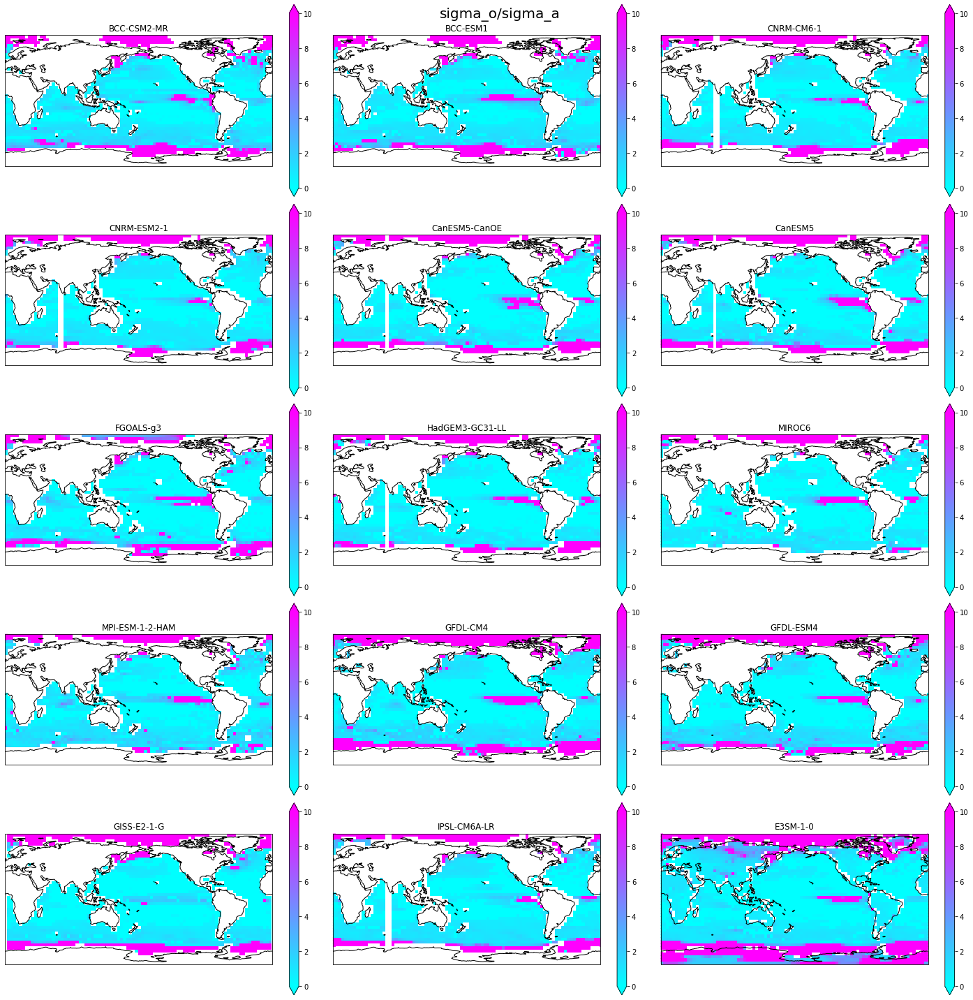

In [139]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in coeffs_list['model'].values:
    ax = fig.add_subplot(5,3,i, projection=ccrs.PlateCarree(central_longitude=180))
    coeffs_list.sel(model=model).sel(param2='coeff').sel(param1='r').plot(ax=ax, transform=ccrs.PlateCarree(), 
                                                                         vmin=0, vmax=10, cmap='cool')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('sigma_o/sigma_a', fontsize=20, y=0.99)

Text(0.5, 1.0, 'sigma_o/sigma_a  (N=15)')

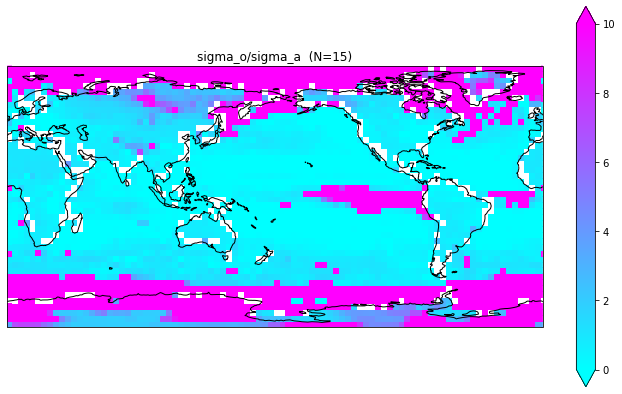

In [145]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
coeffs_list.sel(param1='r').sel(param2='coeff').mean('model').plot(ax=ax, transform=ccrs.PlateCarree(), 
                                                                 vmin=0, vmax=10, cmap='cool')
ax.coastlines(color='black', linewidth=1)
plt.title('sigma_o/sigma_a  (N=15)')

Text(0.5, 0.99, 'lambda_a')

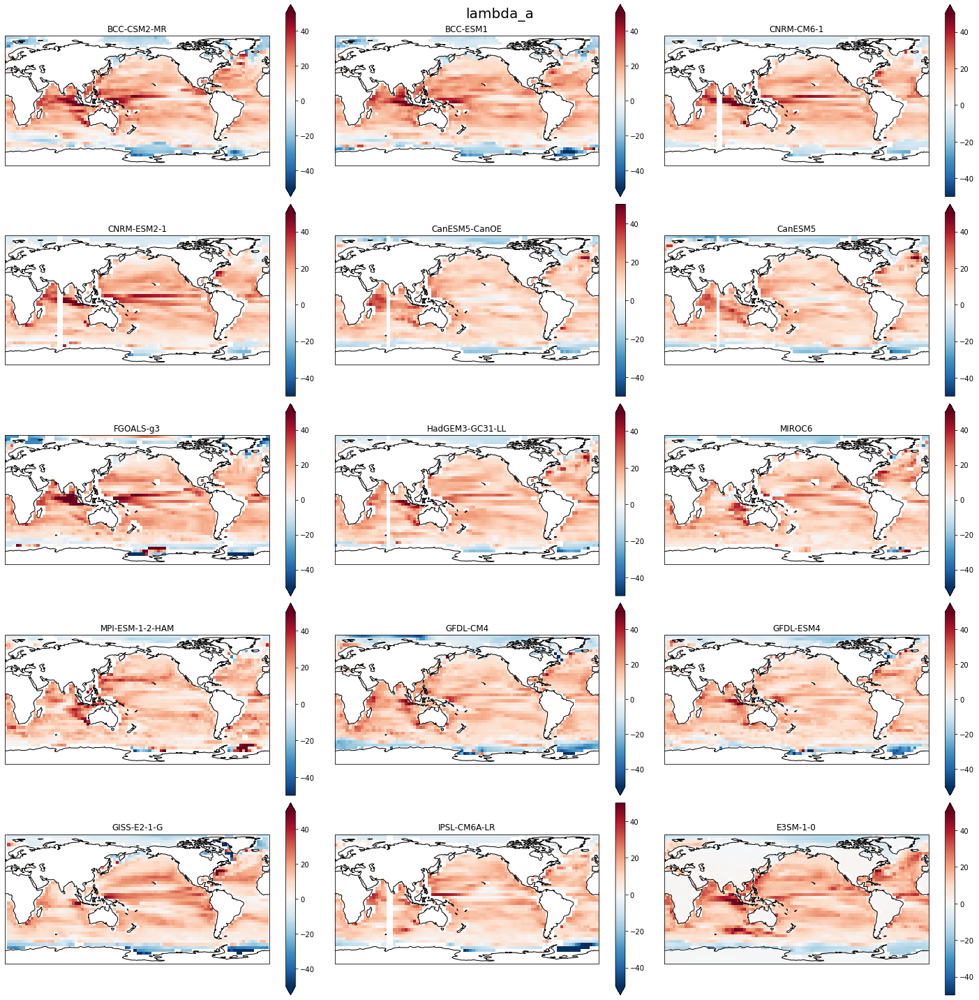

In [97]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in coeffs_list['model'].values:
    ax = fig.add_subplot(5,3,i, projection=ccrs.PlateCarree(central_longitude=180))
    coeffs_list.sel(model=model).sel(param2='coeff').sel(param1='lambda_a').plot(ax=ax, transform=ccrs.PlateCarree(), 
                                                                         vmin=-50, vmax=50, cmap='RdBu_r')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('lambda_a', fontsize=20, y=0.99)

Text(0.5, 1.0, 'lambda_a (N=15)')

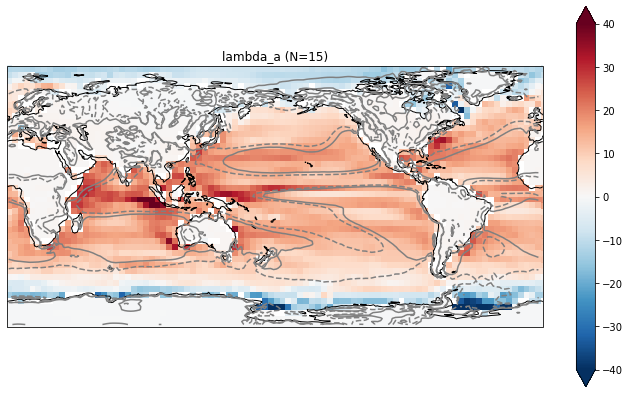

In [106]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
coeffs_list.sel(param1='lambda_a').sel(param2='coeff').mean('model').plot(ax=ax, transform=ccrs.PlateCarree(), 
                                                                 vmin=-40, vmax=40, cmap='RdBu_r')
ax.coastlines(color='black', linewidth=1)
vert_ds.plot.contour(ax=ax, transform=ccrs.PlateCarree(), colors='#808080', levels=[-0.005,0.005])
plt.title('lambda_a (N=15)')

Text(0.5, 0.99, 'lambda_o')

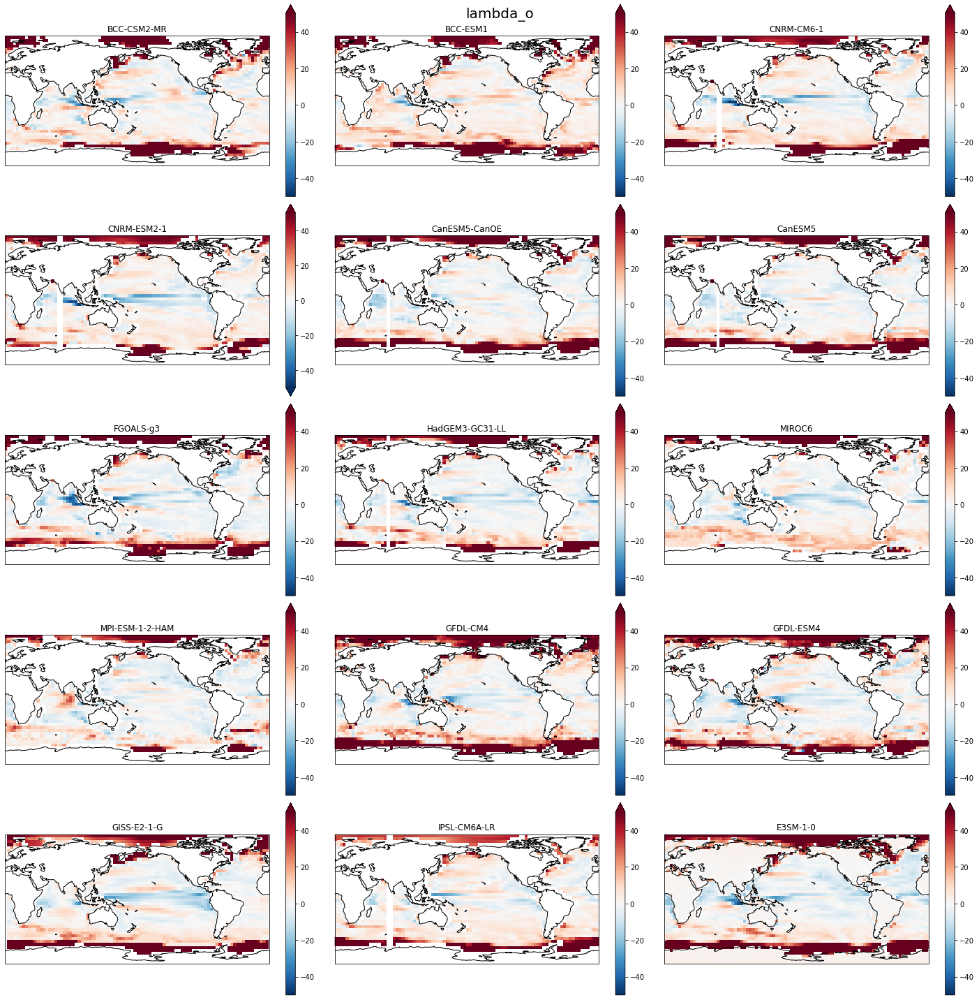

In [107]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in coeffs_list['model'].values:
    ax = fig.add_subplot(5,3,i, projection=ccrs.PlateCarree(central_longitude=180))
    coeffs_list.sel(model=model).sel(param2='coeff').sel(param1='lambda_o').plot(ax=ax, transform=ccrs.PlateCarree(), 
                                                                         vmin=-50, vmax=50, cmap='RdBu_r')
    ax.coastlines(color='black', linewidth=1)
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('lambda_o', fontsize=20, y=0.99)

Text(0.5, 1.0, 'lambda_o (N=15)')

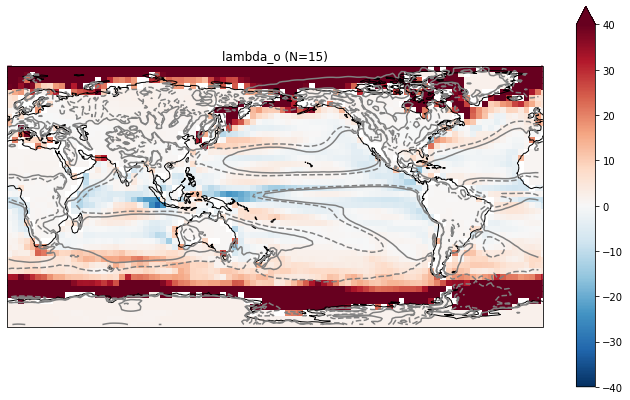

In [109]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
coeffs_list.sel(param1='lambda_o').sel(param2='coeff').mean('model').plot(ax=ax, transform=ccrs.PlateCarree(), 
                                                                 vmin=-40, vmax=40, cmap='RdBu_r')
ax.coastlines(color='black', linewidth=1)
vert_ds.plot.contour(ax=ax, transform=ccrs.PlateCarree(), colors='#808080', levels=[-0.005,0.005])
plt.title('lambda_o (N=15)')

Text(0.5, 0.99, 'r covariance')

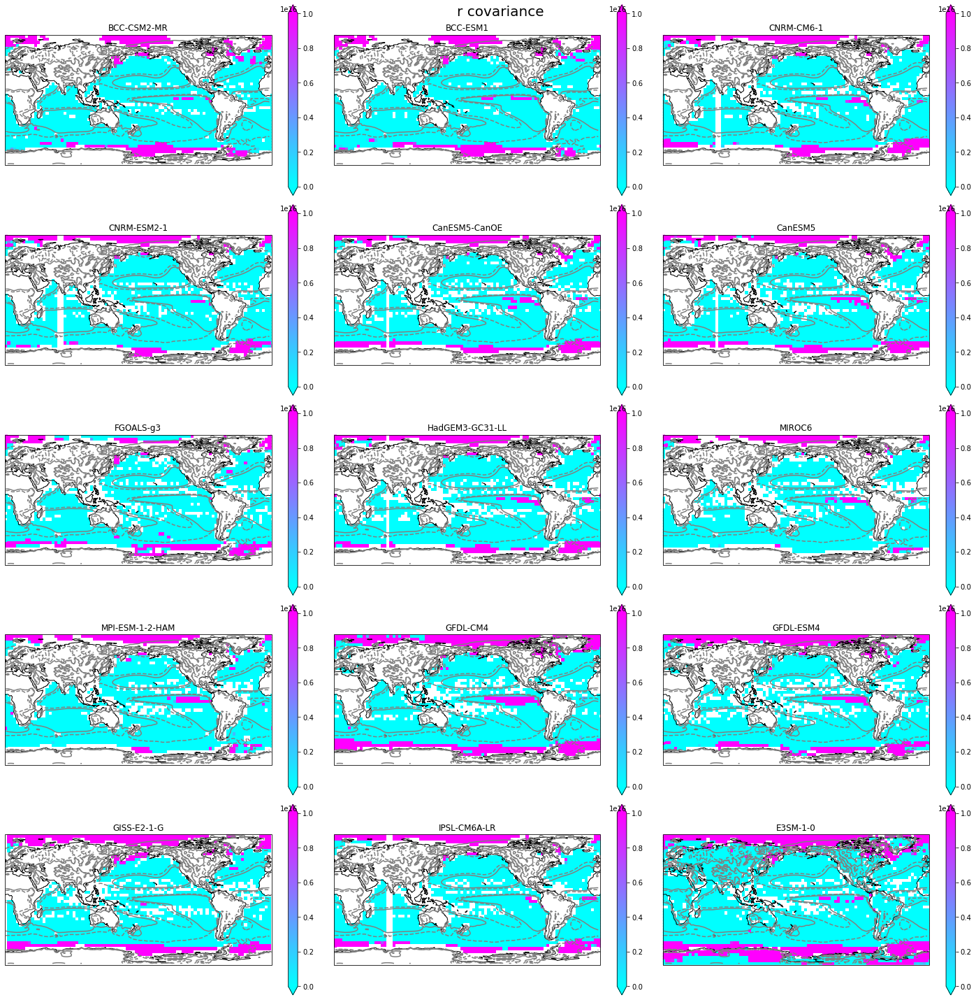

In [147]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in coeffs_list['model'].values:
    ax = fig.add_subplot(5,3,i, projection=ccrs.PlateCarree(central_longitude=180))
    coeffs_list.sel(model=model).sel(param2='cov1').sel(param1='r').plot(ax=ax, transform=ccrs.PlateCarree(), 
                                                                         vmin=0.01, vmax=10e15, 
                                                                        # norm=matplotlib.colors.LogNorm(), 
                                                                         cmap='cool')
    ax.coastlines(color='black', linewidth=1)
    vert_ds.plot.contour(ax=ax, transform=ccrs.PlateCarree(), colors='#808080', levels=[-0.005,0.005])
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('r covariance', fontsize=20, y=0.99)

Text(0.5, 1.0, 'r covariance (N=15)')

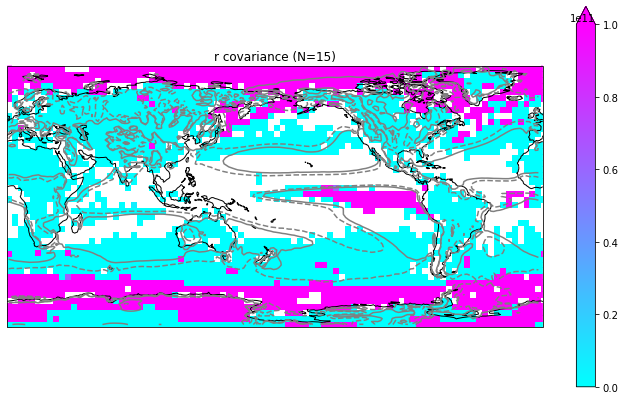

In [16]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
coeffs_list.sel(param2='cov1').sel(param1='r').mean('model').plot(ax=ax, transform=ccrs.PlateCarree(), 
                                                                 vmin=-1, vmax=10e10, 
                                                                   #norm=matplotlib.colors.LogNorm(), 
                                                                   cmap='cool')
ax.coastlines(color='black', linewidth=1)
vert_ds.plot.contour(ax=ax, transform=ccrs.PlateCarree(), colors='#808080', levels=[-0.005,0.005])
plt.title('r covariance (N=15)')

Text(0.5, 0.99, 'lambda_a covariance')

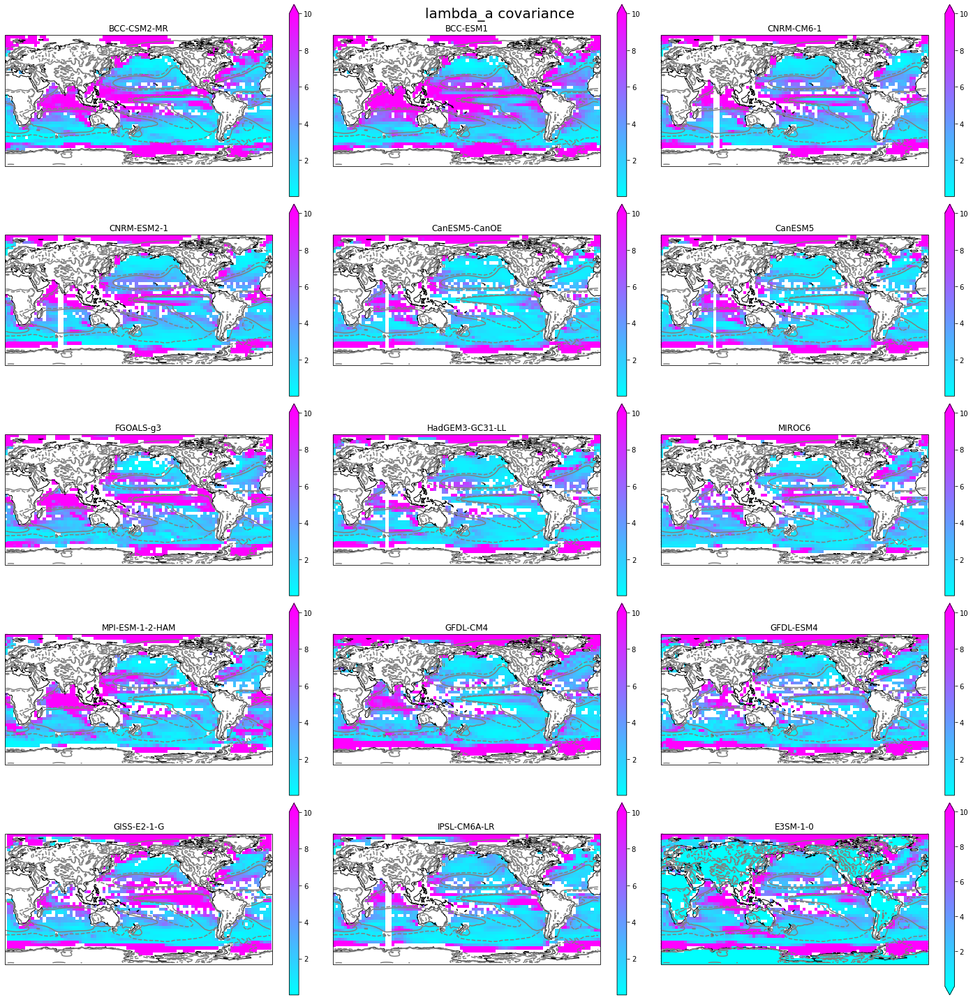

In [136]:
fig = plt.figure(figsize=(20,20))
gs = gridspec.GridSpec(1, 2)
gs.update(wspace=0.1)

i = 1

for model in coeffs_list['model'].values:
    ax = fig.add_subplot(5,3,i, projection=ccrs.PlateCarree(central_longitude=180))
    coeffs_list.sel(model=model).sel(param2='cov2').sel(param1='lambda_a').plot(ax=ax, transform=ccrs.PlateCarree(),
                                                                         vmin=0.01, vmax=10, 
                                                                          cmap='cool')
    ax.coastlines(color='black', linewidth=1)
    vert_ds.plot.contour(ax=ax, transform=ccrs.PlateCarree(), colors='#808080', levels=[-0.005,0.005])
    plt.title(model)
    i += 1
plt.tight_layout()
plt.suptitle('lambda_a covariance', fontsize=20, y=0.99)

Text(0.5, 1.0, 'lambda_a covariance (N=15)')

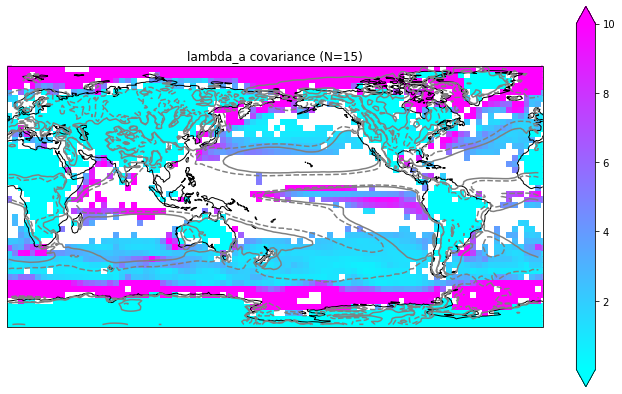

In [150]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
coeffs_list.sel(param1='lambda_a').sel(param2='cov2').mean('model').plot(ax=ax, transform=ccrs.PlateCarree(), 
                                                                 vmin=0.01, vmax=10, 
                                                                   #norm=matplotlib.colors.LogNorm(), 
                                                                    cmap='cool')
ax.coastlines(color='black', linewidth=1)
vert_ds.plot.contour(ax=ax, transform=ccrs.PlateCarree(), colors='#808080', levels=[-0.005,0.005])
plt.title('lambda_a covariance (N=15)')

In [17]:
def fitonemodel(lagint, model, reinterp=False):
    """
    Function for fitting one model.
    
    Input:
     - lagint (int)    - The lag interval to be used (years)
     - model (str)     - The model to be used 
     - reinterp (bool) - Indicator of whether to reinterpolate the data or not (Automatically False)
     
    Output:
     - coeffs_list (Dataarray)     - Array of fit coefficients (lat, lon, param)
     - coeffs_cov_list (Dataarray) - Array of fit coefficient covariances (lat, lon, covparam1, covparam2)
     
    """
    autoregress = automaticRegression() # Instantiate the automaticRegression class.
    density = 1026 #Water density - kg/m3
    c_p = 3850 #Specific heat of salt water - J/kgC
    dt = 60*60*24*30 # Amount of seconds in a month - s
    
    lag_series = np.arange(-lagint*12,lagint*12,1)*dt
    lag_series_doub = np.concatenate((lag_series, lag_series)) # x input for the fit
    error_array = xr.DataArray(np.zeros((44,90)), dims=['lat', 'lon'])

    # Instantiate the arrays to hold the coefficients and the covariances
    coeffs_list = xr.DataArray(np.zeros((44,90,3)), dims=['lat','lon','param'])
    coeffs_cov_list = xr.DataArray(np.zeros((44,90,3,3)), dims=['lat','lon','covparam1', 'covparam2'])
    
    # Reinterpolation
    if reinterp==True:
        new_lats=np.arange(-87,88,4) # Currently a 4x4 grid
        new_lons=np.arange(1,359,4)

        Qs_reinterp = dataarray_Qs_cont.interp(lat=new_lats, lon=new_lons)
        Qo_reinterp = dataarray_Qo_cont.interp(lat=new_lats, lon=new_lons)
        SST_reinterp = dataarray_SST_cont.interp(lat=new_lats, lon=new_lons)
        mlotst_reinterp = mlotst.interp(lat=new_lats, lon=new_lons)
    else:
        Qs_reinterp = dataarray_Qs_cont
        Qo_reinterp = dataarray_Qo_cont
        SST_reinterp = dataarray_SST_cont
        mlotst_reinterp = mlotst
        
    lat_index = 0
    for lat in Qs_reinterp['lat'].values:
        lon_index = 0
        print(lat)
        for lon in Qs_reinterp['lon'].values:
            # Retrieving the mixed layer depth for the location we want.
            mlotst_mean = mlotst_reinterp.sel(lat=lat,method='nearest').sel(lon=lon,method='nearest'
                                                                           ).sel(name=model).mean('time')
            print(mlotst_mean)
            if mlotst_mean == 0: # Skip if there's no ocean.
                lon_index += 1
                continue
                
            autoregress.c = c_p*density*mlotst_mean.values # Heat capacity
            
            # Picking out the location we're using
            Qs_slice = Qs_reinterp.sel(lat=lat,method='nearest').sel(lon=lon,method='nearest').sel(name=model)
            Qo_slice = Qo_reinterp.sel(lat=lat,method='nearest').sel(lon=lon,method='nearest').sel(name=model)
            SST_slice = SST_reinterp.sel(lat=lat,method='nearest').sel(lon=lon,method='nearest').sel(name=model)

            # Cleaning the data for NaNs
            Qs_cleaned = autoregress.reinterp(Qs_slice)
            Qo_cleaned = autoregress.reinterp(Qo_slice)
            SST_cleaned = autoregress.reinterp(SST_slice)

            # If an array is entirely NaNs, skip.
            if (type(Qs_cleaned) == str) or (type(SST_cleaned) == str) or (type(Qo_cleaned) == str):
                lon_index += 1
                continue
                
            # Doing the regression
            atm_list = autoregress.lagregress(Qs_cleaned, SST_cleaned, lagint*12)
            oce_list = autoregress.lagregress(Qo_cleaned, SST_cleaned, lagint*12)
            
            atm_lag = atm_list[0]
            if atm_list:
                laglist = atm_list[1]
            else:
                laglist = np.array([])
                atm_lag = np.array([])
            
            if oce_list:
                oce_lag = oce_list[0]
            else:
                oce_lag = np.array([])
                
            concat_list = np.concatenate((atm_lag, oce_lag))
            if concat_list.any():
                try:
                    i = 0
                    with warnings.catch_warnings(record=True) as warning_list:
                        warnings.simplefilter("default")
                        coeffs, coeffs_cov = curve_fit(autoregress.analytical_eq, lag_series_doub, concat_list)
                        if len(warning_list) > i:
                            i += 1
                            print('lon' + str(lon))
                            error_array[lat_index, lon_index] = 1
                except RuntimeError:
                    coeffs = np.full([3], np.nan)
                    coeffs_cov = np.full([3,3], np.nan)
                finally:
                    coeffs_list[lat_index, lon_index, :] = coeffs
                    coeffs_cov_list[lat_index, lon_index, :, :] = coeffs_cov
            else:
                coeffs_list[lat_index, lon_index, :] = np.full([3], np.nan)
                coeffs_cov_list[lat_index, lon_index, :, :] = np.full([3,3], np.nan)
            lon_index += 1
        lat_index += 1

    return coeffs_list, coeffs_cov_list, error_array

## CanESM5

In [18]:
# 2 year, 4x4 grid. Catch all warnings
coeffs_canesm_2yr_warn, coeffs_cov_canesm_2yr_warn, error_array = fitonemodel(2, 'CanESM5', reinterp=True)

-87
-83
-79
-75
-71
-67
-63
-59
-55
-51
-47
-43
-39
-35
lon137
-31
lon37
lon49
-27
lon49
lon69
lon161
lon169
lon173
lon325
-23
lon41
lon61
lon69
lon81
lon97
lon105
lon169
lon173
lon205
-19
lon57
lon65
lon97
lon101
lon105
lon109
lon189
lon193
lon197
lon205
lon209
lon217
lon221
lon225
lon325
lon329
-15
lon5
lon117
lon185
lon189
lon193
lon201
lon209
lon213
lon217
lon221
lon233
lon237
lon241
lon257
lon261
lon265
lon329
lon333
lon341
-11
lon1
lon9
lon109
lon113
lon121
lon153
lon161
lon165
lon169
lon173
lon181
lon185
lon197
lon205
lon209
lon213
lon217
lon329
lon341
-7
lon101
lon105
lon165
lon173
lon177
lon181
lon197
-3
lon97
lon185
lon189
lon193
1
lon1
lon5
lon77
lon81
lon85
lon93
lon97
5
lon85
lon157
lon165
lon317
lon341
lon345
lon349
9
lon69
lon89
lon113
lon133
lon137
lon145
lon153
lon161
lon173
lon177
lon181
lon185
lon189
lon193
lon197
lon205
lon209
lon217
lon221
lon229
lon233
lon245
lon321
13
lon137
lon237
lon241
lon249
lon253
lon257
lon265
lon317
lon321
lon337
17
lon69
lon93
lon129
lon1

In [18]:
# 2 year, 4x4 grid. Catch all warnings
coeffs_canesm_2yr_warn, coeffs_cov_canesm_2yr_warn, error_array = fitonemodel(2, 'CanESM5', reinterp=True)

-87
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -87
    lon        int64 1
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -87
    lon        int64 5
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -87
    lon        int64 9
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -87
    lon        int64 13
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -87
    lon        int64 17
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       

<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -87
    lon        int64 345
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -87
    lon        int64 349
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -87
    lon        int64 353
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -87
    lon        int64 357
-83
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -83
    lon        int64 1
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name 

<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -83
    lon        int64 345
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -83
    lon        int64 349
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -83
    lon        int64 353
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 nan
    longitude  float64 nan
    name       <U7 'CanESM5'
    lat        int64 -83
    lon        int64 357
-79
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 -79.0
    longitude  float64 1.0
    name       <U7 'CanESM5'
    lat        int64 -79
    lon        int64 1
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 -79.0
    longitude  float64 5.0
    n

<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 -79.0
    longitude  float64 -11.0
    name       <U7 'CanESM5'
    lat        int64 -79
    lon        int64 349
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 -79.0
    longitude  float64 -7.0
    name       <U7 'CanESM5'
    lat        int64 -79
    lon        int64 353
<xarray.DataArray ()>
array(0.)
Coordinates:
    latitude   float64 -79.0
    longitude  float64 -3.0
    name       <U7 'CanESM5'
    lat        int64 -79
    lon        int64 357
-75
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -75.0
    longitude  float64 1.0
    name       <U7 'CanESM5'
    lat        int64 -75
    lon        int64 1
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -75.0
    longitude  float64 5.0
    name       <U7 'CanESM5'
    lat        int64 -75
    lon        int64 5
[   0    1    2 ...

<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -75.0
    longitude  float64 -235.0
    name       <U7 'CanESM5'
    lat        int64 -75
    lon        int64 125
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -75.0
    longitude  float64 -231.0
    name       <U7 'CanESM5'
    lat        int64 -75
    lon        int64 129
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -75.0
    longitude  float64 -227.0
    name       <U7 'CanESM5'
    lat        int64 -75
    lon        int64 133
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -75.0
    longitude  float64 -223.0
    name       <U7 'CanESM5'
    lat        int64 -75
    lon        int64 137
[   0    1    2 ... 1497 1498 1499]
[]


[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -75.0
    longitude  float64 -103.0
    name       <U7 'CanESM5'
    lat        int64 -75
    lon        int64 257
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -75.0
    longitude  float64 -99.0
    name       <U7 'CanESM5'
    lat        int64 -75
    lon        int64 261
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -75.0
    longitude  float64 -95.0
    name       <U7 'CanESM5'
    lat        int64 -75
    lon        int64 265
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -75.0
    longitude  float64 -91.0
    name       <U7 'CanESM5'
    lat        in

<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -71.0
    longitude  float64 25.0
    name       <U7 'CanESM5'
    lat        int64 -71
    lon        int64 25
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -71.0
    longitude  float64 29.0
    name       <U7 'CanESM5'
    lat        int64 -71
    lon        int64 29
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -71.0
    longitude  float64 33.0
    name       <U7 'CanESM5'
    lat        int64 -71
    lon        int64 33
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -71.0
    longitude  float64 37.0
    name       <U7 'CanESM5'
    lat        int64 -71
    lon        int64 37
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1  

[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -71.0
    longitude  float64 -199.0
    name       <U7 'CanESM5'
    lat        int64 -71
    lon        int64 161
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -71.0
    longitude  float64 -195.0
    name       <U7 'CanESM5'
    lat        int64 -71
    lon        int64 165
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -71.0
    longitude  float64 -191.0
    name       <U7 'CanESM5'
    lat        int64 -71
    lon        int64 169
[   0    1    2 ... 1497 1498 1499]
[]
[   0    1    2 ... 1797 1798 1799]
<xarray.DataArray ()>
array(nan)
Coordinates:
    latitude   float64 -71.0
    longitude  float64 -187.0
    name       <U7 'CanESM5'
    lat        int64 -71
    lon        int64 173
[  

KeyboardInterrupt: 

AttributeError: 'Rectangle' object has no property 'cmap'

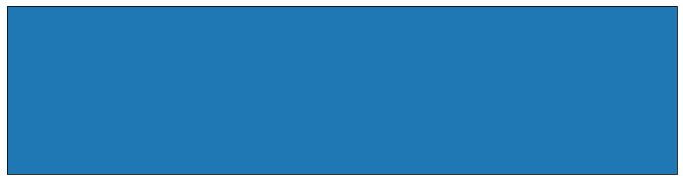

In [20]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_2yr_warn.plot(ax=ax, transform=ccrs.PlateCarree(), cmap='RdBu_r')
ax.coastlines(color='black', linewidth=1)
plt.title('sigma_o/sigma_a  (N=15)')

In [ ]:
coeffs

In [5]:
# 5 year, 4x4 grid
coeffs_canesm_5yr, coeffs_cov_canesm_5yr = fitonemodel(5, 'CanESM5', reinterp=True)

-87
-83
-79
-75
-71
-67
-63
-59
-55
-51


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


-47
-43
-39
-35


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


-31


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


-27


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-23


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-19


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-15


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-11


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-7


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-3


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


1


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

5


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

9


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

13


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

17


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

21


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

25


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

29
33
37
41


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


45


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


49


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


53


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


57


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


61
65


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


69
73
77
81
85


In [7]:
# Putting in new coordinates
coeffs_canesm_5yr.coords['lon'] = Qs_reinterp['lon'].values
coeffs_canesm_5yr.coords['lat'] = Qs_reinterp['lat'].values
coeffs_canesm_5yr.coords['param'] = np.array(['r', 'lambda_a', 'lambda_o'])

In [10]:
# Same, but for the covariances
coeffs_cov_canesm_5yr.coords['lon'] = Qs_reinterp['lon'].values
coeffs_cov_canesm_5yr.coords['lat'] = Qs_reinterp['lat'].values
coeffs_cov_canesm_5yr.coords['covparam1'] = ['r', 'lambda_a', 'lambda_o']
coeffs_cov_canesm_5yr.coords['covparam2'] = ['r', 'lambda_a', 'lambda_o']

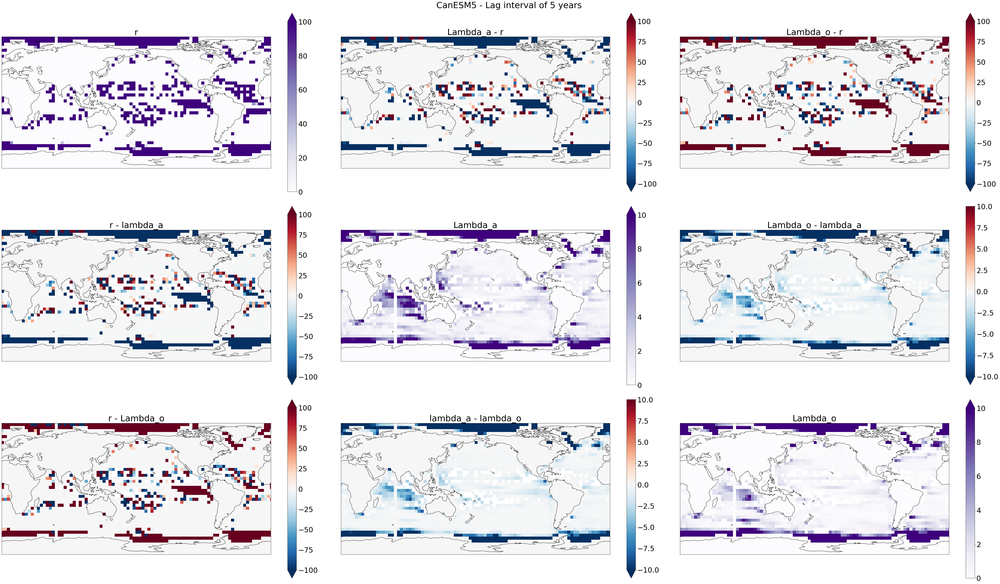

In [16]:
# 4x4 - 2/7

fig = plt.figure(figsize=(60, 35))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(331, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='r').sel(covparam2='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=100,
                                                             cmap='Purples')
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('r')

ax2 = fig.add_subplot(332, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='lambda_a').sel(covparam2='r').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a - r')

ax3 = fig.add_subplot(333, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='lambda_o').sel(covparam2='r').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o - r')

ax4 = fig.add_subplot(334, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='r').sel(covparam2='lambda_a').plot(ax=ax4, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
ax4.coastlines(color='black', linewidth=1)
ax4.set_title('r - lambda_a')

ax5 = fig.add_subplot(335, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='lambda_a').sel(covparam2='lambda_a').plot(ax=ax5, transform=ccrs.PlateCarree(),
                                                                               vmin=0, vmax=10, cmap='Purples')
ax5.coastlines(color='black', linewidth=1)
ax5.set_title('Lambda_a')

ax6 = fig.add_subplot(336, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='lambda_o').sel(covparam2='lambda_a').plot(ax=ax6, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
ax6.coastlines(color='black', linewidth=1)
ax6.set_title('Lambda_o - lambda_a')

ax7 = fig.add_subplot(337, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='r').sel(covparam2='lambda_o').plot(ax=ax7, transform=ccrs.PlateCarree(),
                                                                        vmin=-100, vmax=100, cmap='RdBu_r')
ax7.coastlines(color='black', linewidth=1)
ax7.set_title('r - Lambda_o')

ax8 = fig.add_subplot(338, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='lambda_a').sel(covparam2='lambda_o').plot(ax=ax8, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
ax8.coastlines(color='black', linewidth=1)
ax8.set_title('lambda_a - lambda_o')

ax9 = fig.add_subplot(339, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='lambda_o').sel(covparam2='lambda_o').plot(ax=ax9, transform=ccrs.PlateCarree(),
                                                                           vmin=0, vmax=10, cmap='Purples')
ax9.coastlines(color='black', linewidth=1)
ax9.set_title('Lambda_o')

plt.suptitle('CanESM5 - Lag interval of 5 years')
fig.tight_layout()

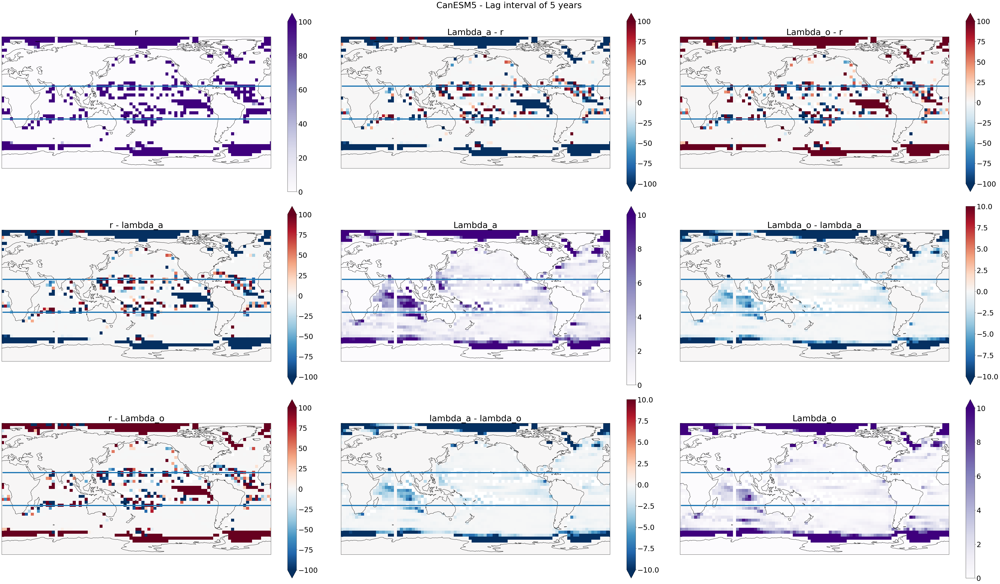

In [17]:
# 4x4 - 2/7

fig = plt.figure(figsize=(60, 35))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(331, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='r').sel(covparam2='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=100,
                                                             cmap='Purples')
plt.hlines(-23, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(21, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('r')

ax2 = fig.add_subplot(332, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='lambda_a').sel(covparam2='r').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.hlines(-23, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(21, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a - r')

ax3 = fig.add_subplot(333, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='lambda_o').sel(covparam2='r').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.hlines(-23, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(21, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o - r')

ax4 = fig.add_subplot(334, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='r').sel(covparam2='lambda_a').plot(ax=ax4, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.hlines(-23, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(21, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax4.coastlines(color='black', linewidth=1)
ax4.set_title('r - lambda_a')

ax5 = fig.add_subplot(335, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='lambda_a').sel(covparam2='lambda_a').plot(ax=ax5, transform=ccrs.PlateCarree(),
                                                                               vmin=0, vmax=10, cmap='Purples')
plt.hlines(-23, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(21, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax5.coastlines(color='black', linewidth=1)
ax5.set_title('Lambda_a')

ax6 = fig.add_subplot(336, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='lambda_o').sel(covparam2='lambda_a').plot(ax=ax6, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
plt.hlines(-23, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(21, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax6.coastlines(color='black', linewidth=1)
ax6.set_title('Lambda_o - lambda_a')

ax7 = fig.add_subplot(337, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='r').sel(covparam2='lambda_o').plot(ax=ax7, transform=ccrs.PlateCarree(),
                                                                        vmin=-100, vmax=100, cmap='RdBu_r')
plt.hlines(-23, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(21, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax7.coastlines(color='black', linewidth=1)
ax7.set_title('r - Lambda_o')

ax8 = fig.add_subplot(338, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='lambda_a').sel(covparam2='lambda_o').plot(ax=ax8, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
plt.hlines(-23, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(21, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax8.coastlines(color='black', linewidth=1)
ax8.set_title('lambda_a - lambda_o')

ax9 = fig.add_subplot(339, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_5yr.sel(covparam1='lambda_o').sel(covparam2='lambda_o').plot(ax=ax9, transform=ccrs.PlateCarree(),
                                                                           vmin=0, vmax=10, cmap='Purples')
plt.hlines(-23, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(21, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax9.coastlines(color='black', linewidth=1)
ax9.set_title('Lambda_o')

plt.suptitle('CanESM5 - Lag interval of 5 years')
fig.tight_layout()

In [31]:
# 2 year, 4x4 grid
coeffs_canesm_4x4, coeffs_cov_canesm_4x4 = fitonemodel(2, 'CanESM5', reinterp=True)

<xarray.DataArray (name: 15, time: 1500, lat: 44, lon: 90)>
array([[[[ 3.39850302e+00,  3.45564645e+00,  3.54994143e+00, ...,
           3.02658408e+00,  3.26545729e+00,  3.32447948e+00],
         [ 4.05409673e+00,  3.91367162e+00,  3.75412048e+00, ...,
           3.48700270e+00,  3.93799453e+00,  4.11297579e+00],
         [ 3.00697538e+00,  3.10236164e+00,  2.91340235e+00, ...,
           2.60121081e+00,  2.72032032e+00,  2.93242683e+00],
         ...,
         [-2.81836731e+01, -2.86374786e+01, -4.63209676e+01, ...,
          -3.26763612e+01, -3.28438603e+01, -3.18796746e+01],
         [-3.06903020e+01, -3.18608265e+01, -3.08182944e+01, ...,
          -5.50215262e+01, -3.20087236e+01, -3.11787532e+01],
         [-2.87204652e+01, -3.01703797e+01, -2.98309441e+01, ...,
          -2.83653765e+01, -2.72294478e+01, -2.71639947e+01]],

        [[-1.77046449e+00, -1.86195850e+00, -2.06648959e+00, ...,
          -1.50688173e+00, -1.55690938e+00, -1.65905673e+00],
         [-2.35685349e+00, -

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


-31


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


-27


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-23


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-19


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-15


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-11


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-7


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-3


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

1


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

5


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

9


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

13


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

17


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

21


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

25


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

29


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


33
37
41


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


45


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


49


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


53


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


57


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


61
65


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


69
73


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


77
81
85


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


In [74]:
# Testing 
coeffs_canesm_4x4, coeffs_cov_canesm_4x4 = fitonemodel(2, 'CanESM5', reinterp=True)

# First output is atm_list
# Second output is atm_lag

-87
-83
-79
-75
-71
[(array([-0.00442694,  0.06924796,  0.10844299,  0.21777789,  0.401881  ,
        0.12783139, -0.09679129,  0.10165239,  0.13494059,  0.12798379,
       -0.03823304, -0.14614307, -0.06223815, -0.03563915, -0.09150741,
       -0.18700388, -0.39744466, -0.31640363,  0.02153125,  0.06002925,
        0.51854382,  1.24936136,  1.49482636,  0.55875635, -1.12004947,
       -1.26031632, -0.58296075, -0.23114888, -0.29917784, -0.31639865,
       -0.28849909, -0.14231799, -0.21859053, -0.12193064,  0.11288582,
        0.06328962,  0.03312743,  0.12084442,  0.14161062,  0.05883579,
       -0.11661689,  0.02554386,  0.06267904, -0.16734412, -0.10501365,
       -0.00724057,  0.07213423,  0.11410409]), array([-24, -23, -22, -21, -20, -19, -18, -17, -16, -15, -14, -13, -12,
       -11, -10,  -9,  -8,  -7,  -6,  -5,  -4,  -3,  -2,  -1,   0,   1,
         2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,
        15,  16,  17,  18,  19,  20,  21,  22,  23]))]
[-0.0044269

KeyboardInterrupt: 

In [95]:
# Testing
coeffs_canesm_4x4, coeffs_cov_canesm_4x4 = fitonemodel(2, 'CanESM5', reinterp=True)

# Testing with different method. Seems to be exactly the same.

-87
-83
-79
-75
-71
(array([-0.00442694,  0.06924796,  0.10844299,  0.21777789,  0.401881  ,
        0.12783139, -0.09679129,  0.10165239,  0.13494059,  0.12798379,
       -0.03823304, -0.14614307, -0.06223815, -0.03563915, -0.09150741,
       -0.18700388, -0.39744466, -0.31640363,  0.02153125,  0.06002925,
        0.51854382,  1.24936136,  1.49482636,  0.55875635, -1.12004947,
       -1.26031632, -0.58296075, -0.23114888, -0.29917784, -0.31639865,
       -0.28849909, -0.14231799, -0.21859053, -0.12193064,  0.11288582,
        0.06328962,  0.03312743,  0.12084442,  0.14161062,  0.05883579,
       -0.11661689,  0.02554386,  0.06267904, -0.16734412, -0.10501365,
       -0.00724057,  0.07213423,  0.11410409]), array([-24, -23, -22, -21, -20, -19, -18, -17, -16, -15, -14, -13, -12,
       -11, -10,  -9,  -8,  -7,  -6,  -5,  -4,  -3,  -2,  -1,   0,   1,
         2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,
        15,  16,  17,  18,  19,  20,  21,  22,  23]))
[-0.00442694 

[-0.03889067 -0.03763191 -0.04814524  0.05392519  0.05531652 -0.03390483
  0.02427928  0.14602457 -0.0010965  -0.03496129  0.03112076 -0.04138513
 -0.05045621 -0.00541947 -0.01970977 -0.10970872 -0.04224775  0.04274776
  0.14037357  0.12408324  0.15577691  0.2067116   0.19354931  0.30639195
  0.73624601 -0.35659676 -0.15898017 -0.03120943  0.01374655  0.0738131
 -0.0130541   0.04233272  0.02921114 -0.11697456 -0.00177113 -0.0337548
 -0.03995617  0.0099933   0.00956944 -0.03601546 -0.01154915 -0.02583208
  0.07008725 -0.04451907  0.01764422  0.02512474 -0.01595996  0.01053688]
(array([-0.08984044, -0.09784309, -0.07933916, -0.00532502,  0.00792485,
       -0.01387025,  0.08959733,  0.13396653,  0.02850701, -0.05138892,
        0.01321867,  0.02179947, -0.05703583, -0.00778851, -0.03615773,
       -0.13909314, -0.07327295,  0.09322648,  0.26494241,  0.2279921 ,
        0.15505762,  0.16600464,  0.26584234,  0.26826123,  0.51454245,
       -0.57994322, -0.26346757, -0.07364063,  0.0259808

(array([-1.71980633e-01, -2.55786290e-01, -2.71347694e-01, -2.12914728e-01,
       -1.63492643e-01,  2.34955635e-02,  2.41562432e-01,  2.57348554e-01,
        1.46197769e-01,  1.14451677e-01, -6.57600656e-02, -1.94976011e-01,
       -4.59034533e-01, -5.79690592e-01, -5.26882406e-01, -3.61689673e-01,
       -1.54959489e-01,  1.51720789e-01,  4.30117854e-01,  6.14971914e-01,
        5.03427447e-01,  3.45793466e-01, -2.96784370e-01, -9.91262129e-01,
       -1.53837653e+00, -2.28065778e+00, -1.44147840e+00, -7.69337060e-01,
       -2.48949158e-01, -8.65118217e-02,  2.22751804e-02, -1.10381918e-03,
       -6.82638020e-02, -1.72973457e-01, -2.71365591e-01, -3.91396101e-01,
       -4.66959029e-01, -4.27091373e-01, -3.09528297e-01, -2.36453118e-01,
       -2.35669883e-01, -7.07325792e-02,  1.03722436e-01,  2.39218044e-01,
       -4.50923848e-02, -3.32303658e-02, -6.53323502e-02, -5.07861783e-02]), array([-24, -23, -22, -21, -20, -19, -18, -17, -16, -15, -14, -13, -12,
       -11, -10,  -9,  -8

(array([ 0.05148484, -0.0897468 , -0.02255816, -0.01322123, -0.00433801,
       -0.04571912, -0.01587675,  0.00258904, -0.01679689,  0.0227525 ,
       -0.03145605, -0.0208097 , -0.0171052 , -0.0245782 ,  0.00716634,
        0.02022172, -0.01406373, -0.00136066,  0.04569051,  0.05963581,
        0.0861584 ,  0.04541256,  0.01362745,  0.06358947,  0.87252308,
       -0.02281473, -0.00886037,  0.02243773,  0.01069313,  0.03098554,
        0.03753736,  0.01303656, -0.06346228,  0.03373644, -0.01002443,
       -0.04645909,  0.00278152, -0.02892292, -0.13439574, -0.02907851,
       -0.06441349, -0.14086879, -0.03812396,  0.03540695,  0.03747844,
        0.02900189,  0.02221607, -0.10244208]), array([-24, -23, -22, -21, -20, -19, -18, -17, -16, -15, -14, -13, -12,
       -11, -10,  -9,  -8,  -7,  -6,  -5,  -4,  -3,  -2,  -1,   0,   1,
         2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,
        15,  16,  17,  18,  19,  20,  21,  22,  23]))
[ 0.05148484 -0.0897468  -0.02255

[-0.32871745 -0.23024981 -0.36051434 -0.36644503 -0.29934373 -0.04983681
 -0.0855036  -0.10781321 -0.21755997 -0.13805297  0.12287526 -0.03596594
 -0.21321165 -0.26229211 -0.32121289 -0.18800704 -0.0896733   0.13600802
  0.42130095  0.37571354  0.59911169  0.50932737  0.23787777 -0.3327152
 -0.75451116 -2.07040522 -1.0338464  -0.39862364 -0.19982594 -0.16567177
 -0.1221662  -0.20271378 -0.1688777  -0.14552835 -0.30310433 -0.25984954
 -0.46263952 -0.25724231 -0.13119868 -0.05799609  0.09847886  0.19382385
  0.14331784 -0.10214862 -0.13372604 -0.09079698 -0.16627083 -0.37465326]
(array([-0.32793304, -0.26880162, -0.38993646, -0.31554984, -0.2218302 ,
       -0.04992707, -0.09024747, -0.0668082 , -0.11007367, -0.07454981,
        0.08129081, -0.01921652, -0.19217921, -0.33635094, -0.38951423,
       -0.20734251, -0.0785245 ,  0.12757539,  0.49473402,  0.41643354,
        0.6122791 ,  0.50925509,  0.19745747, -0.24099497, -0.58375966,
       -1.79356555, -0.87918858, -0.28822452, -0.083876

(array([-2.20326794e-01, -3.11662555e-01, -2.90583973e-01, -2.65705720e-01,
       -1.34356638e-01,  2.39707898e-01,  3.58492765e-01,  1.45615429e-01,
        5.78814914e-03, -9.32512653e-02, -3.29822089e-02, -2.61735599e-02,
       -4.62420125e-02, -7.40719045e-02, -1.61145708e-01, -1.71707360e-01,
        1.46880481e-01,  2.52884757e-01,  6.19825601e-01,  9.98597394e-01,
        9.72513303e-01,  7.21564983e-01,  2.97528310e-01, -1.08785459e-01,
       -6.52852547e-01, -1.76671348e+00, -8.19652385e-01, -3.35066496e-01,
       -1.73393441e-01, -8.48984763e-02, -7.42255009e-02, -9.15303639e-02,
        9.15228307e-02, -3.88396660e-01, -2.38689630e-01, -4.05159162e-01,
       -3.96392366e-01, -2.49340638e-01, -6.70217209e-02, -6.11528609e-02,
        1.71837879e-03,  7.33609315e-02,  1.33535196e-01,  3.58556108e-02,
       -5.94791969e-02, -9.20486605e-02, -2.91755837e-01, -7.14004421e-02]), array([-24, -23, -22, -21, -20, -19, -18, -17, -16, -15, -14, -13, -12,
       -11, -10,  -9,  -8

[-1.04952237 -1.24843309 -1.11611621 -0.59349403 -0.20844592 -0.03655869
  0.04391591 -0.0864369  -0.17851866 -0.2577629  -0.57457616 -0.76621803
 -0.86328727 -1.0301605  -0.87494364 -0.52498376  0.02164518  0.51219229
  0.63350963  0.60643136  0.46348929  0.14574113 -0.61784496 -1.69243996
 -2.39655773 -3.84683137 -2.4517143  -1.37764406 -0.63867588 -0.24099978
 -0.43624164 -0.6433487  -0.47850858 -0.77359004 -0.96330507 -1.31384032
 -1.37942416 -1.29865591 -1.04109216 -0.6364546  -0.13374151  0.11767242
  0.23346727  0.23408868 -0.01441684 -0.21180729 -0.45477351 -0.76384757]
(array([-1.56619992, -1.55266124, -1.38449285, -0.81072244, -0.33078852,
       -0.23050005, -0.14488251, -0.26785955, -0.43100764, -0.60349682,
       -1.08908661, -1.34390949, -1.47884287, -1.55752005, -1.21382399,
       -0.70128366, -0.14866018,  0.29874269,  0.50863984,  0.41867707,
        0.20868024, -0.22560294, -0.9493347 , -1.96663621, -2.58214566,
       -4.15316017, -2.70930561, -1.5549778 , -0.81774

(array([-0.52837759, -0.23456218, -0.26611587, -0.13255036,  0.05173802,
       -0.20909889, -0.24577473, -0.25267938, -0.30991764, -0.22569763,
       -0.26436294, -0.09246181, -0.41273171, -0.34497529, -0.12428332,
        0.2629558 ,  0.34994859,  0.44011161,  0.45280684,  0.43570036,
        0.24863042, -0.14722203, -0.6111204 , -0.9012112 , -1.18088892,
       -3.15409044, -1.98072107, -1.08187607, -0.70952467, -0.58006248,
       -0.6621133 , -0.76661307, -0.97582625, -0.64062051, -0.74649623,
       -0.52208298, -0.31000817, -0.25857437, -0.01901921,  0.32270073,
        0.39483325,  0.27249695,  0.13020092, -0.04484471, -0.36960417,
       -0.28927825, -0.45832838, -0.73618855]), array([-24, -23, -22, -21, -20, -19, -18, -17, -16, -15, -14, -13, -12,
       -11, -10,  -9,  -8,  -7,  -6,  -5,  -4,  -3,  -2,  -1,   0,   1,
         2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,
        15,  16,  17,  18,  19,  20,  21,  22,  23]))
[-0.52837759 -0.23456218 -0.26611

[ 0.18413526  0.11232068  0.02763907 -0.08922512 -0.338417   -0.38311701
 -0.39006215 -0.24266982  0.17588683  0.39164984  0.40659087  0.37690041
 -0.15030943  0.04741257  0.1340718   0.15931932  0.17944702  0.17139475
  0.17054866  0.18028532  0.28072329  0.02839619 -0.16499896 -0.38290478
 -0.13251696 -2.23982726 -1.09059465 -0.58296422 -0.07665488 -0.10439629
 -0.21261102 -0.1995315  -0.32398851 -0.17879058 -0.0341563   0.06761331
  0.10229868  0.18362116  0.14447476  0.34104973  0.33655137  0.18935573
 -0.00925247 -0.30264666 -0.0358823   0.04575684  0.11102102 -0.05609798]
(array([ 0.22974683,  0.10154248,  0.05703666, -0.05099456, -0.29397572,
       -0.4006948 , -0.24584044, -0.19111267,  0.24414887,  0.42658476,
        0.40989773,  0.3656868 , -0.18464706,  0.00578392,  0.06227913,
        0.12096652,  0.08224673,  0.01101263,  0.0847098 ,  0.13784714,
        0.32032996,  0.13732512, -0.07442422, -0.30865249,  0.09280543,
       -2.13077358, -0.92251037, -0.51220416,  0.02664

[-0.10818466  0.02006233 -0.06296052  0.0938047   0.09315891  0.21178823
  0.12754895  0.121592    0.02147823  0.09692857  0.11647361  0.05393396
 -0.01061056 -0.08202867  0.00864843 -0.03887182  0.01109959 -0.01287698
  0.15769142  0.41226972  0.51368103  0.72333935  0.5703686   0.41232213
  0.68971232 -0.17966547 -0.02039838 -0.00732765  0.03654033  0.01367078
 -0.16581202 -0.2112492  -0.14464894 -0.0486022   0.02348966 -0.01601479
  0.09399374  0.02209438 -0.09021322 -0.16723154 -0.24822537 -0.19333947
 -0.11377933 -0.24428854 -0.08665915 -0.04493328 -0.02584321 -0.0588854 ]
(array([-0.06017713, -0.02340625, -0.11564939,  0.00746816, -0.01664297,
        0.1554928 ,  0.12142369,  0.15420033, -0.02359168,  0.0540587 ,
        0.0621426 ,  0.05211946, -0.02847356, -0.07080261,  0.04020663,
        0.03365542,  0.01379922, -0.01863683,  0.10820671,  0.38064955,
        0.44719255,  0.68093361,  0.5445365 ,  0.38358954,  0.73135428,
       -0.23967655, -0.10412411, -0.03384879,  0.05285

(array([ 0.05210941, -0.03324732, -0.06417436, -0.0930028 , -0.03964768,
       -0.0017535 ,  0.0260796 , -0.03489194, -0.03413899,  0.1000287 ,
        0.0204348 ,  0.01021776, -0.05183616,  0.00618448,  0.05093436,
        0.05765724,  0.11979529,  0.05031955,  0.10211791,  0.21778728,
        0.48199226,  0.45282093,  0.33892078,  0.20027389,  0.56791603,
       -0.39592675, -0.1818258 , -0.05447089,  0.01485837,  0.03174215,
        0.01241822, -0.01343119, -0.05639181,  0.07982303, -0.02949326,
       -0.09070197, -0.12263775, -0.1256514 , -0.12018246,  0.00338743,
       -0.04009761, -0.18919997, -0.08947153,  0.03100335,  0.07790189,
       -0.00330634,  0.0289661 , -0.00641684]), array([-24, -23, -22, -21, -20, -19, -18, -17, -16, -15, -14, -13, -12,
       -11, -10,  -9,  -8,  -7,  -6,  -5,  -4,  -3,  -2,  -1,   0,   1,
         2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,
        15,  16,  17,  18,  19,  20,  21,  22,  23]))
[ 0.05210941 -0.03324732 -0.06417

KeyboardInterrupt: 

In [6]:
# Generating new latitudes and longitudes
new_lats=np.arange(-87,88,4)
new_lons=np.arange(1,359,4)
Qs_reinterp = dataarray_Qs_cont.interp(lat=new_lats, lon=new_lons)

In [33]:
# Putting in new coordinates
coeffs_canesm_4x4.coords['lon'] = Qs_reinterp['lon'].values
coeffs_canesm_4x4.coords['lat'] = Qs_reinterp['lat'].values
coeffs_canesm_4x4.coords['param'] = np.array(['r', 'lambda_a', 'lambda_o'])

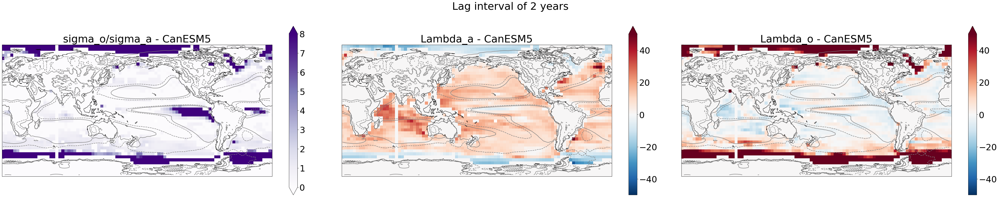

In [8]:
# 4x4 - 2/7

fig = plt.figure(figsize=(50, 10))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(131, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_4x4.sel(param='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=8, cmap='Purples')
ax1.coastlines(color='black', linewidth=1)
vert_ds.plot.contour(ax=ax1, transform=ccrs.PlateCarree(), colors='#808080', levels=[-0.005,0.005])
ax1.set_title('sigma_o/sigma_a - CanESM5')

ax2 = fig.add_subplot(132, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_4x4.sel(param='lambda_a').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-50, vmax=50, cmap='RdBu_r')
ax2.coastlines(color='black', linewidth=1)
vert_ds.plot.contour(ax=ax2, transform=ccrs.PlateCarree(), colors='#808080', levels=[-0.005,0.005])
ax2.set_title('Lambda_a - CanESM5')

ax3 = fig.add_subplot(133, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_4x4.sel(param='lambda_o').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-50, vmax=50, cmap='RdBu_r')
ax3.coastlines(color='black', linewidth=1)
vert_ds.plot.contour(ax=ax3, transform=ccrs.PlateCarree(), colors='#808080', levels=[-0.005,0.005])
ax3.set_title('Lambda_o - CanESM5')

plt.suptitle('Lag interval of 2 years')
fig.tight_layout()

In [ ]:
# 4x4 - 2/7

fig = plt.figure(figsize=(50, 10))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(131, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_4x4.sel(param='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=8, cmap='Purples')
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('sigma_o/sigma_a - CanESM5')

ax2 = fig.add_subplot(132, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_4x4.sel(param='lambda_a').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-50, vmax=50, cmap='RdBu_r')
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a - CanESM5')

ax3 = fig.add_subplot(133, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_4x4.sel(param='lambda_o').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-50, vmax=50, cmap='RdBu_r')
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o - CanESM5')

plt.suptitle('Lag interval of 2 years')
fig.tight_layout()

In [36]:
# Save
coeffs_canesm_4x4.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/regress_coeffs/CMIP_coeffs_canesm5_4x4_2yr.nc')

In [38]:
# Same, but for the covariances
coeffs_cov_canesm_4x4.coords['lon'] = Qs_reinterp['lon'].values
coeffs_cov_canesm_4x4.coords['lat'] = Qs_reinterp['lat'].values

In [40]:
coeffs_cov_canesm_4x4.coords['covparam1'] = ['r', 'lambda_a', 'lambda_o']
coeffs_cov_canesm_4x4.coords['covparam2'] = ['r', 'lambda_a', 'lambda_o']

In [41]:
coeffs_cov_canesm_4x4

<xarray.DataArray (lat: 44, lon: 90, covparam1: 3, covparam2: 3)>
array([[[[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

        [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

        [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

        ...,

        [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

        [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
...
         [-1.42801781e+11,  2.99268561e+02, -3.22400024e+02],
         [ 1.23169753e+11, -3.22400024e+02,  4.76787164e+02]],

        [[ 2.67508480e+19, -1.24126070e+11,  1.19374120e+11],
         [-1.24126070e+11,  6.90823539e+02, -7.86493405e+02],
         [ 1.19374120e+11, -7.86493405e+02,  1.14425714e+03]],

        ...,

        [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
         [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

        [[ 2.89814005e+20, -1.87956718e+11,  2.36406339e+11],
         [-1.87956718e+11,  1.43070411e+02, -1.96125961e+02],
         [ 2.36406339e+11, -1.96125961e+02,  3.05938877e+02]],

        [[ 4.48835475e+20, -2.25598282e+11,  2.52037761e+11],
         [-2.25598282e+11,  1.34133898e+02, -1.68616917e+02],
         [ 2.52037761e+11, -1.68616917e+02,  2.52248052e+02]]]])
Coordinates:
  * lon        (lon) int64 1 5 9 13 17 21 25 29 ... 333 337 341 345 349 353 357
  * lat        (lat) int64 -87 -83 -79 -75 -71 -67 -63 ... 61 65 69 73 77 81 85
  * covparam1  (covparam1) <U8 'r' 'lambda_a' 'lambda_o'
  * covparam2  (covparam2) <U8 'r' 'lambda_a' 'lambda_o'

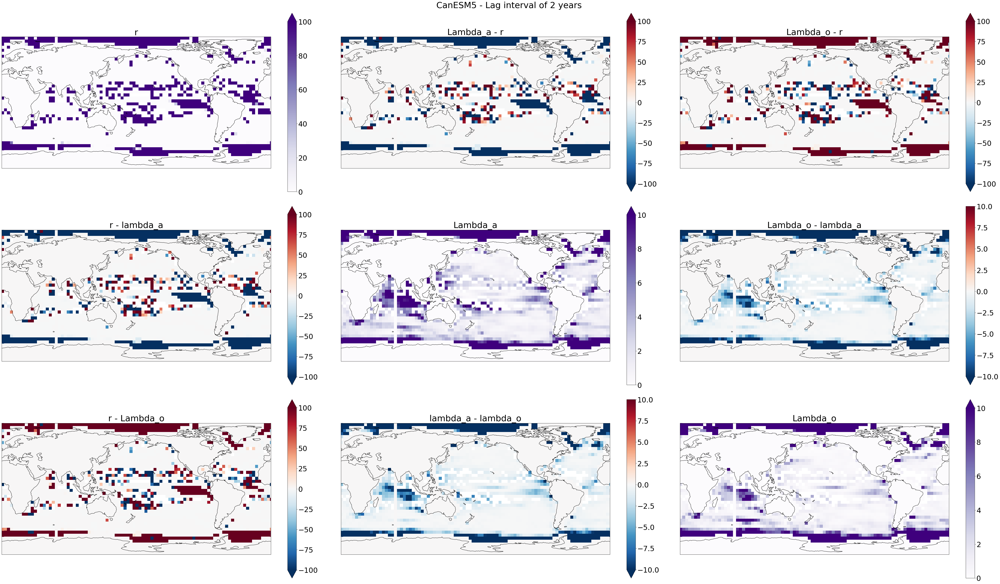

In [97]:
# 4x4 - 2/7

fig = plt.figure(figsize=(60, 35))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(331, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='r').sel(covparam2='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=100,
                                                             cmap='Purples')
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('r')

ax2 = fig.add_subplot(332, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_a').sel(covparam2='r').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a - r')

ax3 = fig.add_subplot(333, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_o').sel(covparam2='r').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o - r')

ax4 = fig.add_subplot(334, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='r').sel(covparam2='lambda_a').plot(ax=ax4, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
ax4.coastlines(color='black', linewidth=1)
ax4.set_title('r - lambda_a')

ax5 = fig.add_subplot(335, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_a').sel(covparam2='lambda_a').plot(ax=ax5, transform=ccrs.PlateCarree(),
                                                                               vmin=0, vmax=10, cmap='Purples')
ax5.coastlines(color='black', linewidth=1)
ax5.set_title('Lambda_a')

ax6 = fig.add_subplot(336, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_o').sel(covparam2='lambda_a').plot(ax=ax6, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
ax6.coastlines(color='black', linewidth=1)
ax6.set_title('Lambda_o - lambda_a')

ax7 = fig.add_subplot(337, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='r').sel(covparam2='lambda_o').plot(ax=ax7, transform=ccrs.PlateCarree(),
                                                                        vmin=-100, vmax=100, cmap='RdBu_r')
ax7.coastlines(color='black', linewidth=1)
ax7.set_title('r - Lambda_o')

ax8 = fig.add_subplot(338, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_a').sel(covparam2='lambda_o').plot(ax=ax8, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
ax8.coastlines(color='black', linewidth=1)
ax8.set_title('lambda_a - lambda_o')

ax9 = fig.add_subplot(339, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_o').sel(covparam2='lambda_o').plot(ax=ax9, transform=ccrs.PlateCarree(),
                                                                           vmin=0, vmax=10, cmap='Purples')
ax9.coastlines(color='black', linewidth=1)
ax9.set_title('Lambda_o')

plt.suptitle('CanESM5 - Lag interval of 2 years')
fig.tight_layout()

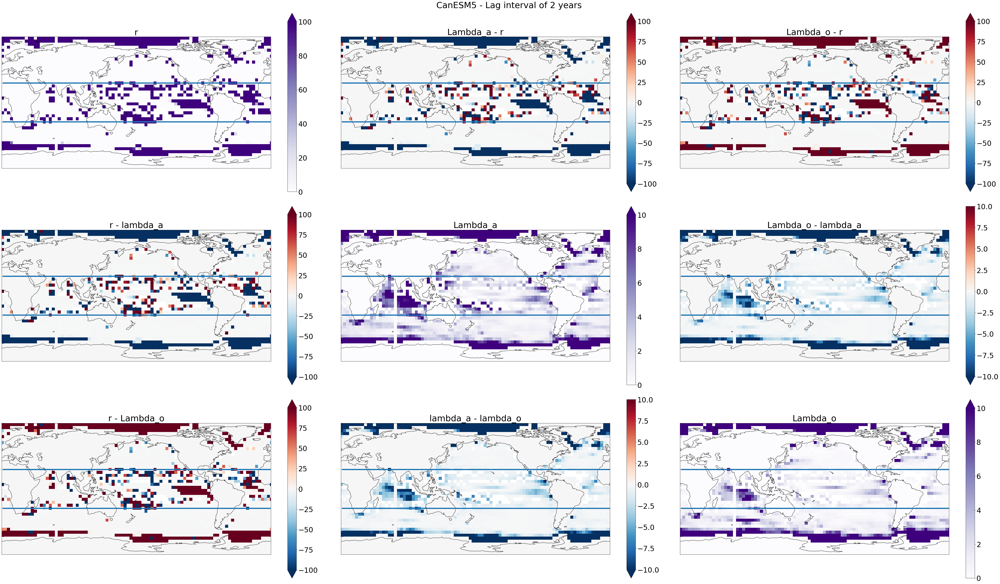

In [10]:
# 4x4 - 2/8 - Where covariance is difficult to estimate

fig = plt.figure(figsize=(60, 35))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(331, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='r').sel(covparam2='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=100,
                                                             cmap='Purples')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('r')

ax2 = fig.add_subplot(332, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_a').sel(covparam2='r').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a - r')

ax3 = fig.add_subplot(333, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_o').sel(covparam2='r').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o - r')

ax4 = fig.add_subplot(334, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='r').sel(covparam2='lambda_a').plot(ax=ax4, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax4.coastlines(color='black', linewidth=1)
ax4.set_title('r - lambda_a')

ax5 = fig.add_subplot(335, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_a').sel(covparam2='lambda_a').plot(ax=ax5, transform=ccrs.PlateCarree(),
                                                                               vmin=0, vmax=10, cmap='Purples')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax5.coastlines(color='black', linewidth=1)
ax5.set_title('Lambda_a')

ax6 = fig.add_subplot(336, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_o').sel(covparam2='lambda_a').plot(ax=ax6, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax6.coastlines(color='black', linewidth=1)
ax6.set_title('Lambda_o - lambda_a')

ax7 = fig.add_subplot(337, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='r').sel(covparam2='lambda_o').plot(ax=ax7, transform=ccrs.PlateCarree(),
                                                                        vmin=-100, vmax=100, cmap='RdBu_r')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax7.coastlines(color='black', linewidth=1)
ax7.set_title('r - Lambda_o')

ax8 = fig.add_subplot(338, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_a').sel(covparam2='lambda_o').plot(ax=ax8, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax8.coastlines(color='black', linewidth=1)
ax8.set_title('lambda_a - lambda_o')

ax9 = fig.add_subplot(339, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_o').sel(covparam2='lambda_o').plot(ax=ax9, transform=ccrs.PlateCarree(),
                                                                           vmin=0, vmax=10, cmap='Purples')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax9.coastlines(color='black', linewidth=1)
ax9.set_title('Lambda_o')

plt.suptitle('CanESM5 - Lag interval of 2 years')
fig.tight_layout()

In [68]:
# Save
coeffs_cov_canesm_4x4.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/regress_coeffs/CMIP_coeffs_covar_canesm5_4x4_2yr.nc')

### 8x8 Grid, 2 years out

In [20]:
# Putting in new coordinates
coeffs_canesm.coords['lon'] = Qs_reinterp['lon'].values
coeffs_canesm.coords['lat'] = Qs_reinterp['lat'].values
coeffs_canesm.coords['param'] = np.array(['r', 'lambda_a', 'lambda_o'])

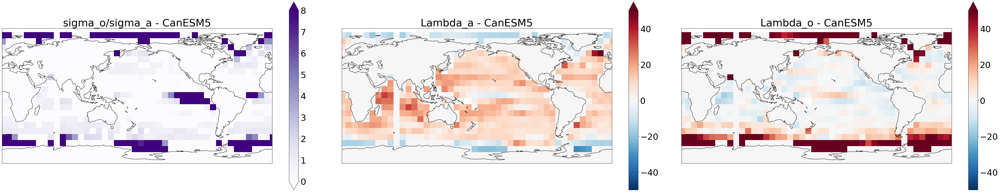

In [29]:
# 8x8 - 2/7

fig = plt.figure(figsize=(50, 10))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(131, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm.sel(param='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=8, cmap='Purples')
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('sigma_o/sigma_a - CanESM5')

ax2 = fig.add_subplot(132, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm.sel(param='lambda_a').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-50, vmax=50, cmap='RdBu_r')
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a - CanESM5')

ax3 = fig.add_subplot(133, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm.sel(param='lambda_o').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-50, vmax=50, cmap='RdBu_r')
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o - CanESM5')

fig.tight_layout()

## GFDL-ESM4, 2 years, 4x4 grid

In [69]:
coeffs_gfdl, coeffs_cov_gfdl = fitonemodel(2, 'GFDL-ESM4', reinterp=True)

<xarray.DataArray (name: 15, time: 1500, lat: 44, lon: 90)>
array([[[[ 3.39850302e+00,  3.45564645e+00,  3.54994143e+00, ...,
           3.02658408e+00,  3.26545729e+00,  3.32447948e+00],
         [ 4.05409673e+00,  3.91367162e+00,  3.75412048e+00, ...,
           3.48700270e+00,  3.93799453e+00,  4.11297579e+00],
         [ 3.00697538e+00,  3.10236164e+00,  2.91340235e+00, ...,
           2.60121081e+00,  2.72032032e+00,  2.93242683e+00],
         ...,
         [-2.81836731e+01, -2.86374786e+01, -4.63209676e+01, ...,
          -3.26763612e+01, -3.28438603e+01, -3.18796746e+01],
         [-3.06903020e+01, -3.18608265e+01, -3.08182944e+01, ...,
          -5.50215262e+01, -3.20087236e+01, -3.11787532e+01],
         [-2.87204652e+01, -3.01703797e+01, -2.98309441e+01, ...,
          -2.83653765e+01, -2.72294478e+01, -2.71639947e+01]],

        [[-1.77046449e+00, -1.86195850e+00, -2.06648959e+00, ...,
          -1.50688173e+00, -1.55690938e+00, -1.65905673e+00],
         [-2.35685349e+00, -

/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


-39
-35


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


-31


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-27


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-23


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-19


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-15


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-11


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-7


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-3


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

1


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

5


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

9


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

13


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

17


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

21


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

25


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

29


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


33


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


37
41
45


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


49


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


53


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


57


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

61
65
69
73
77
81
85


In [84]:
# Save
coeffs_gfdl.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/regress_coeffs/CMIP_coeffs_gfdlesm4_4x4_2yr.nc')

In [86]:
# Save
coeffs_cov_gfdl.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/regress_coeffs/CMIP_coeffs_covar_gfdlesm4_4x4_2yr.nc')

In [17]:
coeffs_gfdl

<xarray.DataArray (lat: 44, lon: 90, param: 3)>
array([[[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

       [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

       [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        ...,
...
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

       [[ 9.24366808e+03, -7.80676275e-02,  2.27555006e+01],
        [ 6.94249748e+03,  2.86763275e+00,  2.10331390e+01],
        [ 4.90778405e+03, -8.68992998e-01,  2.78485515e+01],
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

       [[ 8.88313935e+03, -8.97602945e+00,  6.63973852e+01],
        [ 8.14750325e+03, -8.54113032e+00,  6.41167340e+01],
        [ 1.19979497e+04, -8.24097897e+00,  6.18635887e+01],
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]]])
Dimensions without coordinates: lat, lon, param

In [70]:
# Setting up new coordinates
new_lats=np.arange(-87,88,4)
new_lons=np.arange(1,359,4)
Qs_reinterp = dataarray_Qs_cont.interp(lat=new_lats, lon=new_lons)

In [71]:
# Put in new coordinates
coeffs_gfdl.coords['lon'] = Qs_reinterp['lon'].values
coeffs_gfdl.coords['lat'] = Qs_reinterp['lat'].values
coeffs_gfdl.coords['param'] = np.array(['r', 'lambda_a', 'lambda_o'])

In [75]:
coeffs_gfdl

<xarray.DataArray (lat: 44, lon: 90, param: 3)>
array([[[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

       [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

       [[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        ...,
...
        ...,
        [ 1.07052567e+04, -9.86492516e+00,  6.63519758e+01],
        [ 8.37502034e+03,  1.62036605e-01,  2.59170673e+01],
        [ 5.89025058e+00,  6.14754423e+00,  1.49432302e+01]],

       [[ 9.24366808e+03, -7.80676275e-02,  2.27555006e+01],
        [ 6.94249748e+03,  2.86763275e+00,  2.10331390e+01],
        [ 4.90778405e+03, -8.68992998e-01,  2.78485515e+01],
        ...,
        [ 1.23704760e+04, -1.03763087e+01,  7.11311526e+01],
        [ 1.30003558e+04, -7.82518014e+00,  6.08255201e+01],
        [ 8.88171684e+03, -4.05067103e+00,  3.84745058e+01]],

       [[ 8.88313935e+03, -8.97602945e+00,  6.63973852e+01],
        [ 8.14750325e+03, -8.54113032e+00,  6.41167340e+01],
        [ 1.19979497e+04, -8.24097897e+00,  6.18635887e+01],
        ...,
        [ 8.89640494e+03, -1.02457254e+01,  7.35604808e+01],
        [ 8.84128699e+03, -9.71454739e+00,  7.07839969e+01],
        [ 9.38851630e+03, -9.31003378e+00,  6.84393891e+01]]])
Coordinates:
  * lon      (lon) int64 1 5 9 13 17 21 25 29 ... 333 337 341 345 349 353 357
  * lat      (lat) int64 -87 -83 -79 -75 -71 -67 -63 ... 61 65 69 73 77 81 85
  * param    (param) <U8 'r' 'lambda_a' 'lambda_o'

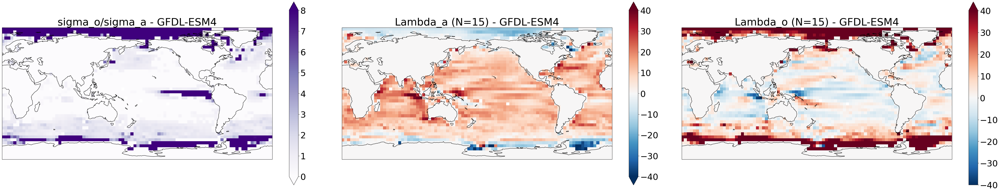

In [79]:
# first try - 2/8

fig = plt.figure(figsize=(50, 10))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(131, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=8, cmap='Purples')
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('sigma_o/sigma_a - GFDL-ESM4')

ax2 = fig.add_subplot(132, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='lambda_a').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-40, vmax=40, cmap='RdBu_r')
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a (N=15) - GFDL-ESM4')

ax3 = fig.add_subplot(133, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='lambda_o').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-40, vmax=40, cmap='RdBu_r')
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o (N=15) - GFDL-ESM4')

fig.tight_layout()

In [82]:
coeffs_cov_gfdl.coords['lon'] = Qs_reinterp['lon'].values
coeffs_cov_gfdl.coords['lat'] = Qs_reinterp['lat'].values
coeffs_cov_gfdl.coords['covparam1'] = ['r', 'lambda_a', 'lambda_o']
coeffs_cov_gfdl.coords['covparam2'] = ['r', 'lambda_a', 'lambda_o']

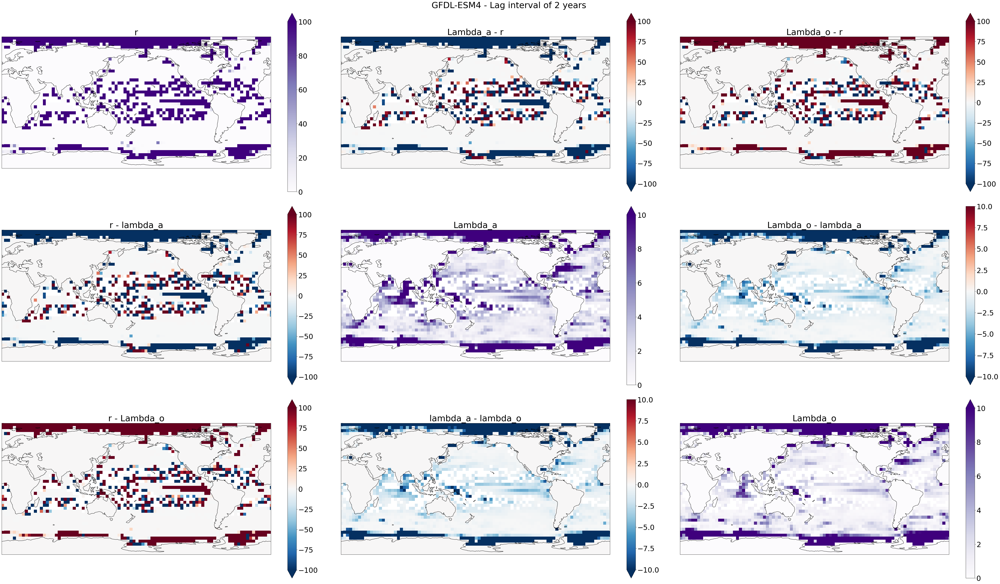

In [96]:
# 4x4 - 2/7

fig = plt.figure(figsize=(60, 35))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(331, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='r').sel(covparam2='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=100,
                                                             cmap='Purples')
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('r')

ax2 = fig.add_subplot(332, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='lambda_a').sel(covparam2='r').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a - r')

ax3 = fig.add_subplot(333, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='lambda_o').sel(covparam2='r').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o - r')

ax4 = fig.add_subplot(334, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='r').sel(covparam2='lambda_a').plot(ax=ax4, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
ax4.coastlines(color='black', linewidth=1)
ax4.set_title('r - lambda_a')

ax5 = fig.add_subplot(335, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='lambda_a').sel(covparam2='lambda_a').plot(ax=ax5, transform=ccrs.PlateCarree(),
                                                                               vmin=0, vmax=10, cmap='Purples')
ax5.coastlines(color='black', linewidth=1)
ax5.set_title('Lambda_a')

ax6 = fig.add_subplot(336, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='lambda_o').sel(covparam2='lambda_a').plot(ax=ax6, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
ax6.coastlines(color='black', linewidth=1)
ax6.set_title('Lambda_o - lambda_a')

ax7 = fig.add_subplot(337, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='r').sel(covparam2='lambda_o').plot(ax=ax7, transform=ccrs.PlateCarree(),
                                                                        vmin=-100, vmax=100, cmap='RdBu_r')
ax7.coastlines(color='black', linewidth=1)
ax7.set_title('r - Lambda_o')

ax8 = fig.add_subplot(338, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='lambda_a').sel(covparam2='lambda_o').plot(ax=ax8, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
ax8.coastlines(color='black', linewidth=1)
ax8.set_title('lambda_a - lambda_o')

ax9 = fig.add_subplot(339, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='lambda_o').sel(covparam2='lambda_o').plot(ax=ax9, transform=ccrs.PlateCarree(),
                                                                           vmin=0, vmax=10, cmap='Purples')
ax9.coastlines(color='black', linewidth=1)
ax9.set_title('Lambda_o')

plt.suptitle('GFDL-ESM4 - Lag interval of 2 years')
fig.tight_layout()

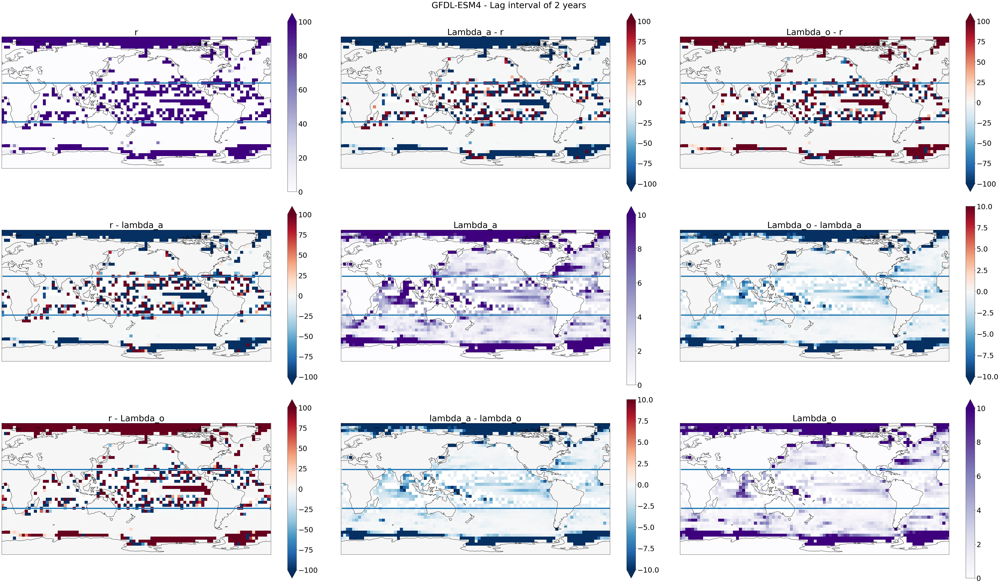

In [14]:
# 4x4 - 2/7

fig = plt.figure(figsize=(60, 35))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(331, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='r').sel(covparam2='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=100,
                                                             cmap='Purples')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('r')

ax2 = fig.add_subplot(332, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='lambda_a').sel(covparam2='r').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a - r')

ax3 = fig.add_subplot(333, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='lambda_o').sel(covparam2='r').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o - r')

ax4 = fig.add_subplot(334, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='r').sel(covparam2='lambda_a').plot(ax=ax4, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax4.coastlines(color='black', linewidth=1)
ax4.set_title('r - lambda_a')

ax5 = fig.add_subplot(335, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='lambda_a').sel(covparam2='lambda_a').plot(ax=ax5, transform=ccrs.PlateCarree(),
                                                                               vmin=0, vmax=10, cmap='Purples')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax5.coastlines(color='black', linewidth=1)
ax5.set_title('Lambda_a')

ax6 = fig.add_subplot(336, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='lambda_o').sel(covparam2='lambda_a').plot(ax=ax6, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax6.coastlines(color='black', linewidth=1)
ax6.set_title('Lambda_o - lambda_a')

ax7 = fig.add_subplot(337, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='r').sel(covparam2='lambda_o').plot(ax=ax7, transform=ccrs.PlateCarree(),
                                                                        vmin=-100, vmax=100, cmap='RdBu_r')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax7.coastlines(color='black', linewidth=1)
ax7.set_title('r - Lambda_o')

ax8 = fig.add_subplot(338, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='lambda_a').sel(covparam2='lambda_o').plot(ax=ax8, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax8.coastlines(color='black', linewidth=1)
ax8.set_title('lambda_a - lambda_o')

ax9 = fig.add_subplot(339, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_gfdl.sel(covparam1='lambda_o').sel(covparam2='lambda_o').plot(ax=ax9, transform=ccrs.PlateCarree(),
                                                                           vmin=0, vmax=10, cmap='Purples')
plt.hlines(-27, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
plt.hlines(25, 1, 360, transform=ccrs.PlateCarree(), linewidth=5.0)
ax9.coastlines(color='black', linewidth=1)
ax9.set_title('Lambda_o')

plt.suptitle('GFDL-ESM4 - Lag interval of 2 years')
fig.tight_layout()

### Testing - Failed attempt

Text(0.5, 1.0, 'sigma_o/sigma_a  (N=15)')

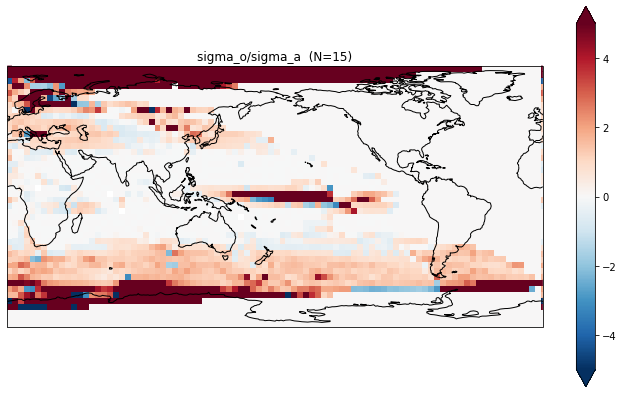

In [23]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='r').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=-5, vmax=5, cmap='RdBu_r')
ax.coastlines(color='black', linewidth=1)
plt.title('sigma_o/sigma_a  (N=15)')

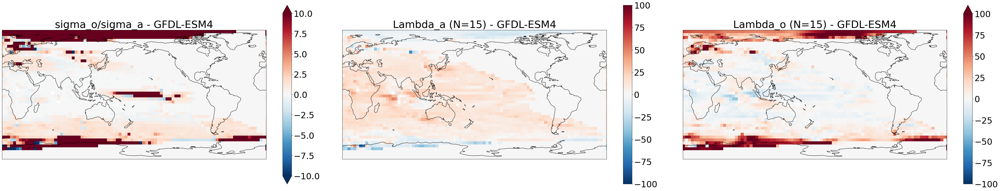

In [25]:
# first try - 2/6

fig = plt.figure(figsize=(50, 10))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(131, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=-10, vmax=10, cmap='RdBu_r')
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('sigma_o/sigma_a - GFDL-ESM4')

ax2 = fig.add_subplot(132, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='lambda_a').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-100, vmax=100, cmap='RdBu_r')
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a (N=15) - GFDL-ESM4')

ax3 = fig.add_subplot(133, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='lambda_o').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-100, vmax=100, cmap='RdBu_r')
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o (N=15) - GFDL-ESM4')

fig.tight_layout()

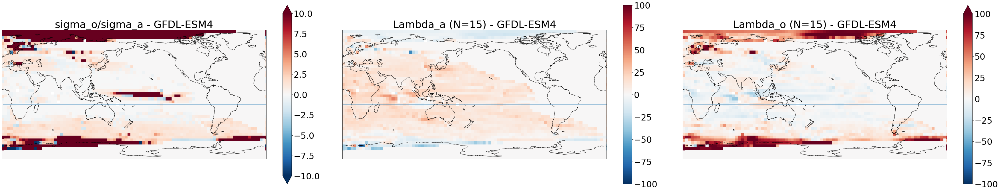

In [36]:
fig = plt.figure(figsize=(50, 10))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(131, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=-10, vmax=10, cmap='RdBu_r')
plt.hlines(-15, 1, 360, transform=ccrs.PlateCarree())
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('sigma_o/sigma_a - GFDL-ESM4')

ax2 = fig.add_subplot(132, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='lambda_a').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-100, vmax=100, cmap='RdBu_r')
plt.hlines(-15, 1, 360, transform=ccrs.PlateCarree())
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a (N=15) - GFDL-ESM4')

ax3 = fig.add_subplot(133, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='lambda_o').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-100, vmax=100, cmap='RdBu_r')
plt.hlines(-15, 1, 360, transform=ccrs.PlateCarree())
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o (N=15) - GFDL-ESM4')

fig.tight_layout()

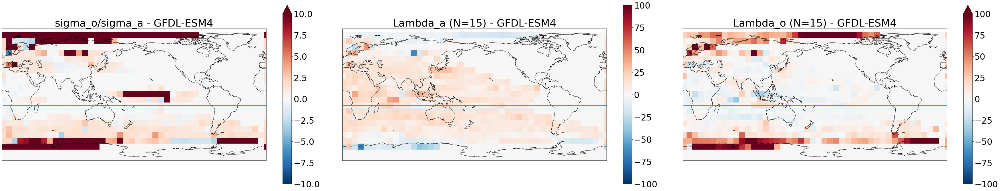

In [14]:
# 8x8 resolution
fig = plt.figure(figsize=(50, 10))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(131, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=-10, vmax=10, cmap='RdBu_r')
plt.hlines(-15, 1, 360, transform=ccrs.PlateCarree())
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('sigma_o/sigma_a - GFDL-ESM4')

ax2 = fig.add_subplot(132, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='lambda_a').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-100, vmax=100, cmap='RdBu_r')
plt.hlines(-15, 1, 360, transform=ccrs.PlateCarree())
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a (N=15) - GFDL-ESM4')

ax3 = fig.add_subplot(133, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_gfdl.sel(param='lambda_o').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-100, vmax=100, cmap='RdBu_r')
plt.hlines(-15, 1, 360, transform=ccrs.PlateCarree())
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o (N=15) - GFDL-ESM4')

fig.tight_layout()

# Fitting - Model Ensemble Mean

In [5]:
def fitting(lagint):
    
    new_lats=np.arange(-87,88,8)
    new_lons=np.arange(1,359,8)

    autoregress = automaticRegression()
    density = 1026 #Water density - kg/m3
    c_p = 3850 #Specific heat of salt water - J/kgC
    dt = 60*60*24*30
    lag_series = np.arange(-lagint*12,lagint*12,1)*dt
    lag_series_doub = np.concatenate((lag_series, lag_series))

    coeffs_list = xr.DataArray(np.zeros((22,45,3)), dims=['lat','lon','param'])
    coeffs_cov_list = xr.DataArray(np.zeros((22,45,3,3)), dims=['lat','lon','covparam1', 'covparam2'])
    
    Qs_reinterp = dataarray_Qs_cont.interp(lat=new_lats, lon=new_lons)
    Qo_reinterp = dataarray_Qo_cont.interp(lat=new_lats, lon=new_lons)
    SST_reinterp = dataarray_SST_cont.interp(lat=new_lats, lon=new_lons)
    mlotst_reinterp = mlotst.interp(lat=new_lats, lon=new_lons)
    
    lat_index = 0
    for lat in Qs_reinterp['lat'].values:
        lon_index = 0
        print(lat)
        for lon in Qs_reinterp['lon'].values:
            mlotst_mean = mlotst_reinterp.sel(lat=lat,method='nearest').sel(lon=lon,method='nearest'
                                                                           ).mean('time').mean('name')
            autoregress.c = c_p*density*mlotst_mean.values # Heat capacity
            atm_lag,oce_lag,laglist=autoregress.lagregress_mean(Qs_reinterp.sel(lat=lat,method='nearest'
                                                                               ).sel(lon=lon,method='nearest'), 
                                                Qo_reinterp.sel(lat=lat,method='nearest').sel(lon=lon,method='nearest'), 
                                                SST_reinterp.sel(lat=lat,method='nearest').sel(lon=lon,method='nearest'),
                                                lagint)
            concat_list = np.concatenate((atm_lag, oce_lag))
            if concat_list.any():
                coeffs, coeffs_cov = curve_fit(autoregress.analytical_eq, lag_series_doub, concat_list)
                coeffs_list[lat_index, lon_index, :] = coeffs
                coeffs_cov_list[lat_index, lon_index, :, :] = coeffs_cov
            else:
                coeffs_list[lat_index, lon_index, :] = np.full([3], np.nan)
                coeffs_cov_list[lat_index, lon_index, :, :] = np.full([3,3], np.nan)
            lon_index += 1
        lat_index += 1
            
    return coeffs_list, coeffs_cov_list

In [6]:
coeffs, coeffs_cov = fitting(1)

-87


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-79


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-71


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


-63
-55
-47
-39
-31
-23


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-15


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

-7


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

1


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

9


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

17


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

25


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not

33
41
49


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


57


/data/keeling/a/mailes2/miniconda3/envs/paleoproj/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


65
73
81


In [9]:
coeffs.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/CMIP_regress_coeffs.nc')

In [15]:
coeffs

<xarray.DataArray (lat: 22, lon: 45, param: 3)>
array([[[-8.67768620e-06,  6.29333500e-02,  1.84283663e-01],
        [-2.17823733e-05,  6.39387776e-02,  1.78110208e-01],
        [-1.95094892e-05,  6.38685740e-02,  1.76690909e-01],
        ...,
        [-2.97873387e-06,  1.08784314e-01,  1.78993652e-01],
        [-2.40634770e-05,  1.04556950e-01,  1.89210334e-01],
        [-2.65876236e-05,  6.80673964e-02,  1.72055593e-01]],

       [[-1.57784576e-05,  1.28835663e-01,  1.66794839e-01],
        [-5.69313203e-05,  1.15260953e-01,  1.78635882e-01],
        [-5.70347576e-05,  1.02690973e-01,  1.89482753e-01],
        ...,
        [ 4.59528611e-01,  1.07841308e-01,  1.69385672e-01],
        [ 8.19012981e-06,  1.32618982e-01,  1.57550435e-01],
        [-1.17283694e-05,  1.31474032e-01,  1.58327884e-01]],

       [[            nan,             nan,             nan],
        [ 1.05604479e+04, -1.25486767e+01,  8.98140126e+01],
        [ 3.82365363e+03, -5.96229828e-01,  2.15150385e+00],
        ...,
...
        ...,
        [ 2.12266393e+00,  1.76653032e-01,  2.84736757e+01],
        [            nan,             nan,             nan],
        [ 1.76964678e+00,  1.14495971e+01,  7.33054729e+00]],

       [[-2.40454967e+00,  8.28723685e+00,  1.87528464e+01],
        [-2.22690219e+00,  9.88522689e+00,  2.17763524e+01],
        [-2.14020006e+00,  1.23924747e+01,  3.33408894e+01],
        ...,
        [            nan,             nan,             nan],
        [ 7.69142484e+03, -1.18836025e+01,  8.65910791e+01],
        [-2.23324059e+00,  1.07758649e+00,  3.56859585e+01]],

       [[ 8.51245219e+03, -9.63062827e+00,  6.81118895e+01],
        [ 1.03572343e+04, -5.06447337e+00,  4.57192492e+01],
        [            nan,             nan,             nan],
        ...,
        [            nan,             nan,             nan],
        [ 8.09279458e+03, -8.16164970e+00,  5.41078647e+01],
        [ 1.03009997e+04, -1.58593585e+01,  1.07614025e+02]]])
Dimensions without coordinates: lat, lon, param

In [16]:
new_lats=np.arange(-87,88,8)
new_lons=np.arange(1,359,8)
Qs_reinterp = dataarray_Qs_cont.interp(lat=new_lats, lon=new_lons)

In [17]:
coeffs.coords['lon'] = Qs_reinterp['lon'].values

In [18]:
coeffs.coords['lat'] = Qs_reinterp['lat'].values

In [16]:
Qs_reinterp['lat'].values

array([-87, -79, -71, -63, -55, -47, -39, -31, -23, -15,  -7,   1,   9,
        17,  25,  33,  41,  49,  57,  65,  73,  81])

In [19]:
coeffs.coords['param'] = np.array(['r', 'lambda_a', 'lambda_o'])

In [20]:
coeffs

<xarray.DataArray (lat: 22, lon: 45, param: 3)>
array([[[-8.67768620e-06,  6.29333500e-02,  1.84283663e-01],
        [-2.17823733e-05,  6.39387776e-02,  1.78110208e-01],
        [-1.95094892e-05,  6.38685740e-02,  1.76690909e-01],
        ...,
        [-2.97873387e-06,  1.08784314e-01,  1.78993652e-01],
        [-2.40634770e-05,  1.04556950e-01,  1.89210334e-01],
        [-2.65876236e-05,  6.80673964e-02,  1.72055593e-01]],

       [[-1.57784576e-05,  1.28835663e-01,  1.66794839e-01],
        [-5.69313203e-05,  1.15260953e-01,  1.78635882e-01],
        [-5.70347576e-05,  1.02690973e-01,  1.89482753e-01],
        ...,
        [ 4.59528611e-01,  1.07841308e-01,  1.69385672e-01],
        [ 8.19012981e-06,  1.32618982e-01,  1.57550435e-01],
        [-1.17283694e-05,  1.31474032e-01,  1.58327884e-01]],

       [[            nan,             nan,             nan],
        [ 1.05604479e+04, -1.25486767e+01,  8.98140126e+01],
        [ 3.82365363e+03, -5.96229828e-01,  2.15150385e+00],
        ...,
...
        ...,
        [ 2.12266393e+00,  1.76653032e-01,  2.84736757e+01],
        [            nan,             nan,             nan],
        [ 1.76964678e+00,  1.14495971e+01,  7.33054729e+00]],

       [[-2.40454967e+00,  8.28723685e+00,  1.87528464e+01],
        [-2.22690219e+00,  9.88522689e+00,  2.17763524e+01],
        [-2.14020006e+00,  1.23924747e+01,  3.33408894e+01],
        ...,
        [            nan,             nan,             nan],
        [ 7.69142484e+03, -1.18836025e+01,  8.65910791e+01],
        [-2.23324059e+00,  1.07758649e+00,  3.56859585e+01]],

       [[ 8.51245219e+03, -9.63062827e+00,  6.81118895e+01],
        [ 1.03572343e+04, -5.06447337e+00,  4.57192492e+01],
        [            nan,             nan,             nan],
        ...,
        [            nan,             nan,             nan],
        [ 8.09279458e+03, -8.16164970e+00,  5.41078647e+01],
        [ 1.03009997e+04, -1.58593585e+01,  1.07614025e+02]]])
Coordinates:
  * lon      (lon) int64 1 9 17 25 33 41 49 57 ... 305 313 321 329 337 345 353
  * lat      (lat) int64 -87 -79 -71 -63 -55 -47 -39 ... 33 41 49 57 65 73 81
  * param    (param) <U8 'r' 'lambda_a' 'lambda_o'

Text(0.5, 1.0, 'Regression of piControl SST and TOA Radiation (N=15)')

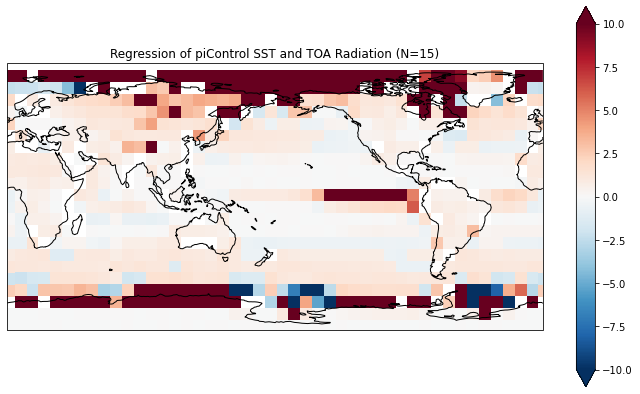

In [7]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
coeffs.sel(param='r').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=-10, vmax=10, cmap='RdBu_r')
ax.coastlines(color='black', linewidth=1)
plt.title('sigma_o/sigma_a  (N=15)')

Text(0.5, 1.0, 'sigma_o/sigma_a  (N=15)')

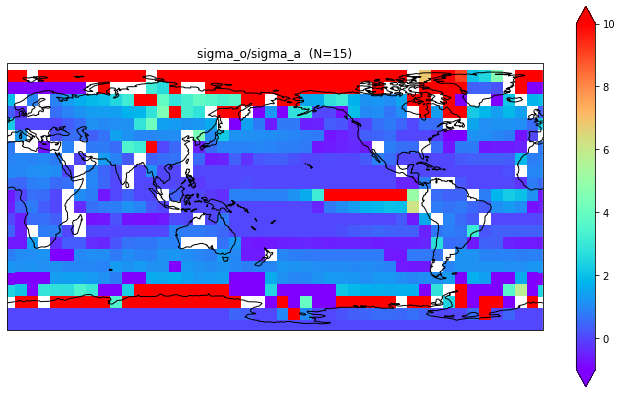

In [31]:
font = {'size'   : 10,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
coeffs.sel(param='r').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=-1, vmax=10, cmap='rainbow')
ax.coastlines(color='black', linewidth=1)
plt.title('sigma_o/sigma_a  (N=15)')

Text(0.5, 1.0, 'Lambda_a (N=15)')

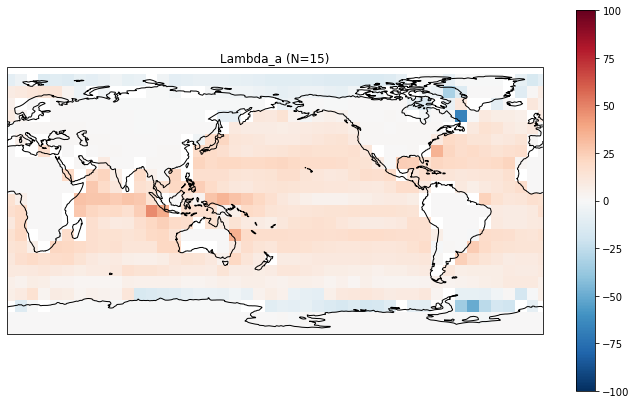

In [9]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
coeffs.sel(param='lambda_a').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=-100, vmax=100, cmap='RdBu_r')
ax.coastlines(color='black', linewidth=1)
plt.title('Lambda_a (N=15)')

Text(0.5, 1.0, 'Lambda_o (N=15)')

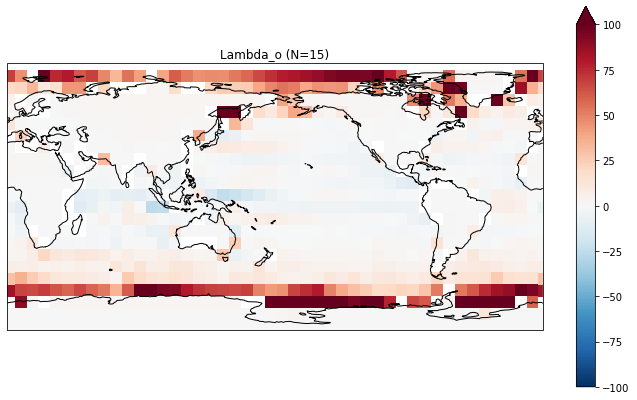

In [8]:
plt.rcParams['figure.figsize'] = [12, 7]
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
coeffs.sel(param='lambda_o').plot(ax=ax, transform=ccrs.PlateCarree(), vmin=-100, vmax=100, cmap='RdBu_r')
ax.coastlines(color='black', linewidth=1)
plt.title('Lambda_o (N=15)')

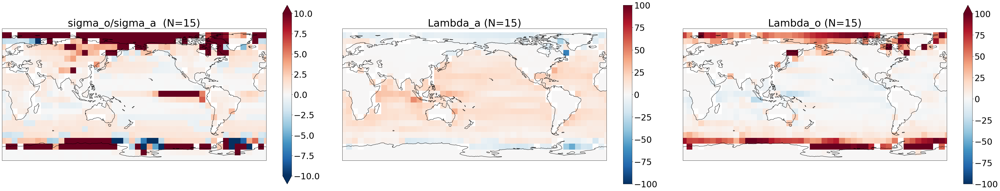

In [14]:
fig = plt.figure(figsize=(50, 10))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(131, projection=ccrs.PlateCarree(central_longitude=180))
coeffs.sel(param='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=-10, vmax=10, cmap='RdBu_r')
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('sigma_o/sigma_a  (N=15)')

ax2 = fig.add_subplot(132, projection=ccrs.PlateCarree(central_longitude=180))
coeffs.sel(param='lambda_a').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-100, vmax=100, cmap='RdBu_r')
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a (N=15)')

ax3 = fig.add_subplot(133, projection=ccrs.PlateCarree(central_longitude=180))
coeffs.sel(param='lambda_o').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-100, vmax=100, cmap='RdBu_r')
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o (N=15)')

fig.tight_layout()

In [39]:
coeffs_cov.to_netcdf('/data/keeling/a/mailes2/a/processed_var_data/CMIP_regress_coeffs_covar.nc')

In [27]:
autoregress = automaticRegression()

density = 1026 #Water density - kg/m3
c_p = 3850 #Specific heat of salt water - J/kgC
dt = 60*60*24*30
lag_series = np.arange(-12,12,1)*dt
lag_series_doub = np.concatenate((lag_series, lag_series))

new_lats=np.arange(-87,88,8)
new_lons=np.arange(1,359,8)
Qs_reinterp = dataarray_Qs_cont.interp(lat=new_lats, lon=new_lons)
Qo_reinterp = dataarray_Qo_cont.interp(lat=new_lats, lon=new_lons)
SST_reinterp = dataarray_SST_cont.interp(lat=new_lats, lon=new_lons)
mlotst_reinterp = mlotst.interp(lat=new_lats, lon=new_lons)

mlotst_mean = mlotst_reinterp.sel(lat=-71,method='nearest').sel(lon=1,method='nearest').mean('time').mean('name')
autoregress.c = c_p*density*mlotst_mean.values # Heat capacity
        
atm_lag,oce_lag,laglist=autoregress.lagregress_mean(Qs_reinterp.sel(lat=-71,method='nearest').sel(lon=1,method='nearest'), 
                                                Qo_reinterp.sel(lat=-71,method='nearest').sel(lon=1,method='nearest'), 
                                                SST_reinterp.sel(lat=-71,method='nearest').sel(lon=1,method='nearest'),
                                                1, 1, -71)
concat_list = np.concatenate((atm_lag, oce_lag))
if concat_list.any():
    coeffs, coeffs_cov = curve_fit(autoregress.analytical_eq, lag_series_doub, concat_list)
    coeffs_list = coeffs
    coeffs_cov_list = coeffs_cov
else:
    coeffs_list = np.full([3], np.nan)
    coeffs_cov_list = np.full([3,3], np.nan)
print(coeffs_list, coeffs_cov_list)

[nan nan nan] [[nan nan nan]
 [nan nan nan]
 [nan nan nan]]


# Testing

In [71]:
autoregress = automaticRegression()
atm_lag_test, oce_lag_test, laglist = autoregress.lagregress_mean(dataarray_Qs_cont, dataarray_Qo_cont, dataarray_SST_cont, 
                                                    5, 210, 0)

Text(0.5, 0.98, '(210,0) - (N=15)')

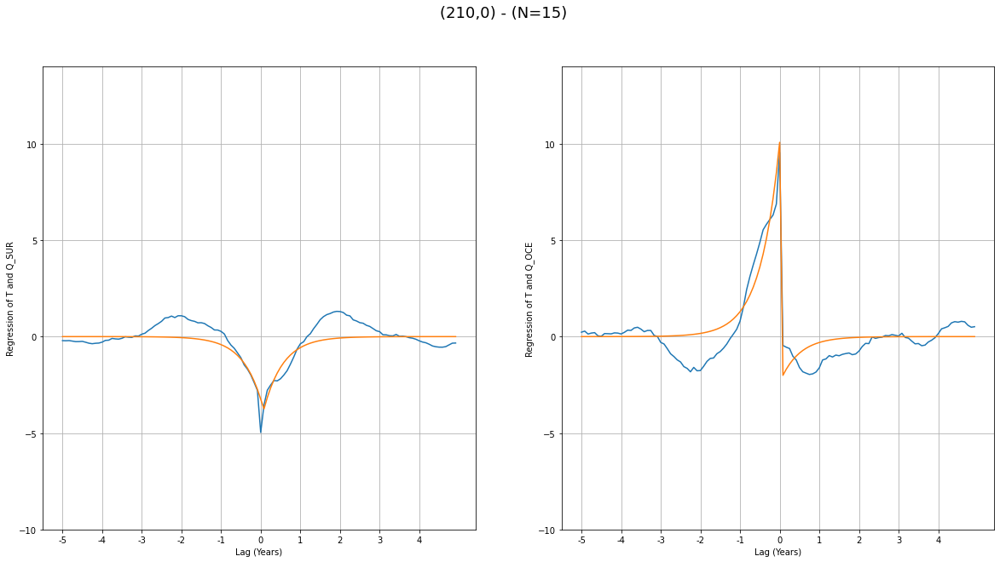

In [21]:
plt.rcParams['figure.figsize'] = [20, 10]
fig, (ax,ax2) = plt.subplots(1,2)

font = {'size'   : 15,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

# Atmosphere
ax.plot(laglist, atm_lag_test)
ax.plot(laglist, fit[:len(fit)//2])
ax.set_xticks(np.arange(-12*5,12*5,12), np.arange(-5,5,1))
ax.set_ylim(-10,14)
ax.set_xlabel('Lag (Years)')
ax.set_ylabel('Regression of T and Q_SUR')
#ax.set_title('Regression slopes vs. Lag (Params: ' + r'$\sigma_a$: ' + str(params['sigma_a']) + r'  $\sigma_o$:' +
#                                              str(params['sigma_o']) + r'  $\lambda_a$:' + str(params['lambda_a']) 
#                                                 + r' $\lambda_o$:' + str(params['lambda_o']) + ')')
ax.grid()

# Ocean
ax2.plot(laglist, oce_lag_test)
ax2.plot(laglist, fit[len(fit)//2:])
ax2.set_xticks(np.arange(-12*5,12*5,12), np.arange(-5,5,1))
ax2.set_ylim(-10,14)
ax2.set_xlabel('Lag (Years)')
ax2.set_ylabel('Regression of T and Q_OCE')
#ax2.set_title('Regression slopes vs. Lag (Params: ' + r'$\sigma_a$: ' + str(params['sigma_a']) + r'  $\sigma_o$:' +
#                                              str(params['sigma_o']) + r'  $\lambda_a$:' + str(params['lambda_a']) 
#                                                 + r' $\lambda_o$:' + str(params['lambda_o']) + ')')
ax2.grid()

plt.suptitle('(210,0) - (N=15)')

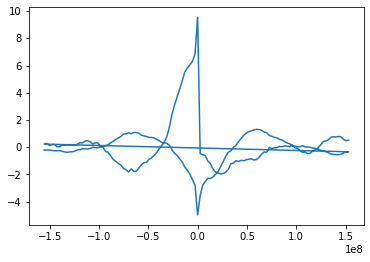

In [72]:
concat_list = np.concatenate((atm_lag_test, oce_lag_test))
lagint = 12*5
dt = 60*60*24*30
lag_series = np.arange(-lagint,lagint,1)*dt
lag_series_doub = np.concatenate((lag_series, lag_series))
plt.plot(lag_series_doub, concat_list)

In [22]:
print(autoregress.c)

103420791.18512361


In [73]:
autoregress = automaticRegression()
density = 1026 #Water density - kg/m3
c_p = 3850 #Specific heat of salt water - J/kgC
mlotst_mean = mlotst.sel(lat=0,method='nearest').sel(lon=210,method='nearest').mean('time').mean('name')
autoregress.c = c_p*density*mlotst_mean.values # Heat capacity

coeffs, coeffs_cov = curve_fit(autoregress.analytical_eq, lag_series_doub, concat_list)

In [74]:
coeffs_cov

array([[ 0.52221394, -0.24694714,  0.11501283],
       [-0.24694714,  0.17721844, -0.07216677],
       [ 0.11501283, -0.07216677,  0.14540425]])

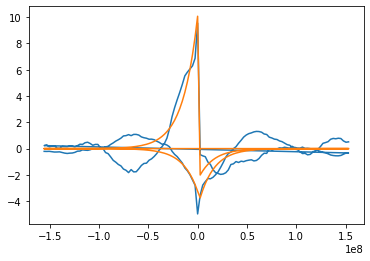

In [15]:
plt.plot(lag_series_doub, concat_list)

fit = autoregress.analytical_eq(lag_series_doub, coeffs[0], coeffs[1], coeffs[2])
plt.plot(lag_series_doub, fit)

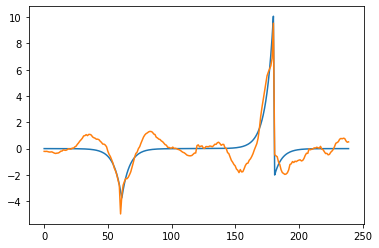

In [17]:
plt.plot(fit)
plt.plot(concat_list)

In [20]:
test()

2


## (270,-5)

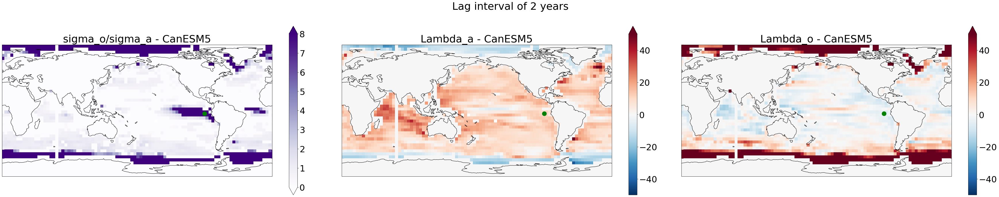

In [54]:
fig = plt.figure(figsize=(50, 10))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

lon=270
lat=-5

ax1 = fig.add_subplot(131, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_4x4.sel(param='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=8, cmap='Purples')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('sigma_o/sigma_a - CanESM5')

ax2 = fig.add_subplot(132, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_4x4.sel(param='lambda_a').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-50, vmax=50, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a - CanESM5')

ax3 = fig.add_subplot(133, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_4x4.sel(param='lambda_o').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-50, vmax=50, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o - CanESM5')

plt.suptitle('Lag interval of 2 years')
fig.tight_layout()

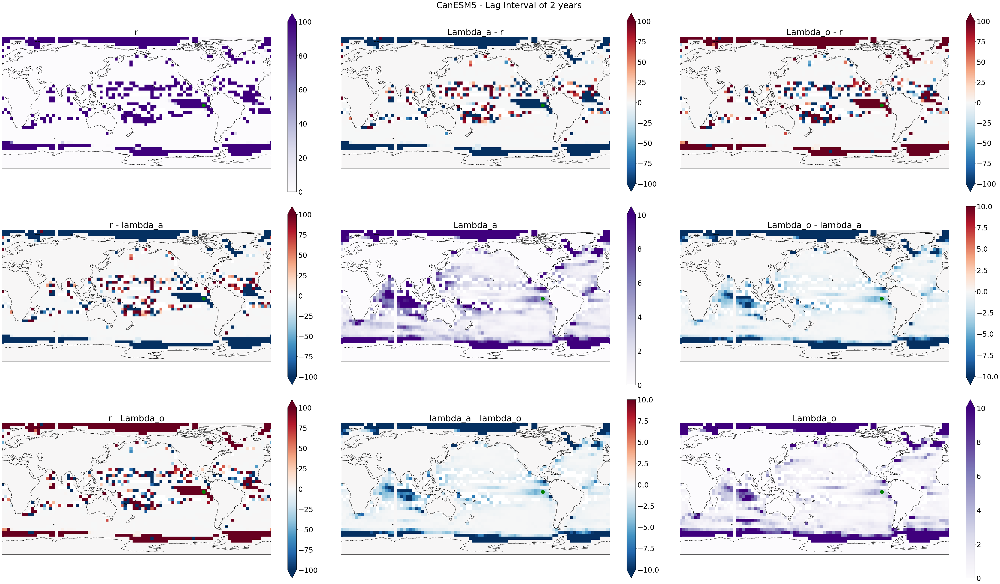

In [34]:
# 4x4 - 2/7

fig = plt.figure(figsize=(60, 35))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(331, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='r').sel(covparam2='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=100,
                                                             cmap='Purples')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('r')

ax2 = fig.add_subplot(332, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_a').sel(covparam2='r').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a - r')

ax3 = fig.add_subplot(333, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_o').sel(covparam2='r').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o - r')

ax4 = fig.add_subplot(334, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='r').sel(covparam2='lambda_a').plot(ax=ax4, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax4.coastlines(color='black', linewidth=1)
ax4.set_title('r - lambda_a')

ax5 = fig.add_subplot(335, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_a').sel(covparam2='lambda_a').plot(ax=ax5, transform=ccrs.PlateCarree(),
                                                                               vmin=0, vmax=10, cmap='Purples')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax5.coastlines(color='black', linewidth=1)
ax5.set_title('Lambda_a')

ax6 = fig.add_subplot(336, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_o').sel(covparam2='lambda_a').plot(ax=ax6, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax6.coastlines(color='black', linewidth=1)
ax6.set_title('Lambda_o - lambda_a')

ax7 = fig.add_subplot(337, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='r').sel(covparam2='lambda_o').plot(ax=ax7, transform=ccrs.PlateCarree(),
                                                                        vmin=-100, vmax=100, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax7.coastlines(color='black', linewidth=1)
ax7.set_title('r - Lambda_o')

ax8 = fig.add_subplot(338, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_a').sel(covparam2='lambda_o').plot(ax=ax8, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax8.coastlines(color='black', linewidth=1)
ax8.set_title('lambda_a - lambda_o')

ax9 = fig.add_subplot(339, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_o').sel(covparam2='lambda_o').plot(ax=ax9, transform=ccrs.PlateCarree(),
                                                                           vmin=0, vmax=10, cmap='Purples')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax9.coastlines(color='black', linewidth=1)
ax9.set_title('Lambda_o')

plt.suptitle('CanESM5 - Lag interval of 2 years')
fig.tight_layout()

In [9]:
coldtongue = coeffs_canesm_4x4.sel(lon=270, method='nearest').sel(lat=-5, method='nearest')

In [10]:
coldtongue

<xarray.DataArray (param: 3)>
array([3251.8990411 ,    9.43620601,   -4.67690905])
Coordinates:
    lon      int64 269
    lat      int64 -3
  * param    (param) object 'r' 'lambda_a' 'lambda_o'

In [24]:
# Analytical solution

def analytical(params, lagint):
    lambda_o = params['lambda_o'] # Ocean feedback
    lambda_a = params['lambda_a'] # Atmospheric feedback
    sigma_a = params['sigma_a']   # Variance of atmospheric forcing
    sigma_o = params['sigma_o']   # Variance of oceanic forcing
    
    dt = 60*60*24*30 # Timestep - month [s]
        
    lag_series = np.arange(-lagint,lagint,1)*dt
        
    c = c_p*density*mlotst_equator # Heat capacity
    
    w_0 = (lambda_a + lambda_o)/c

    eq_secondhalf = (lambda_a + lambda_o) * 2/(sigma_a**2+sigma_o**2) * np.exp(-w_0*abs(lag_series))
    
    for i in range(len(eq_secondhalf)):
        if lag_series[i]>0:
            eq_secondhalf[i] = 0
        else:
            eq_secondhalf[i] = eq_secondhalf[i]
        
    # r_analytical = -np.exp(-lambda_a*abs(lag_series*dt)/c)*lambda_a
    r_atmos = -lambda_a*np.exp(-w_0*abs(lag_series)) + (eq_secondhalf)*sigma_a**2
    r_ocean = -lambda_o*np.exp(-w_0*abs(lag_series)) + (eq_secondhalf)*sigma_o**2

    return r_atmos, r_ocean

In [50]:
params = {}
params['lambda_a'] = 9.43620601
params['lambda_o'] = -4.67690905
params['sigma_a'] = 1
params['sigma_o'] = 3251.8990411
years = 125
lagint = 12*2

density = 1026 #Water density - kg/m3
c_p = 3850 #Specific heat of salt water - J/kgC
seconds = 30*24*60*60 #Time in a week - seconds
mlotst_equator = mlotst.sel(lat=-5,method='nearest').sel(lon=270,method='nearest'
                                                        ).sel(name='CanESM5').mean('time').values

ct_atm, ct_oce = analytical(params, lagint)

In [27]:
def lagregress(Q, SST, lagint):
    
    lag_series = np.arange(-lagint, lagint, 1)
    lagresponse_q = np.zeros(len(lag_series))
    
    i = 0
    for lag in lag_series:
        if lag < 0:
            lagged_Q = Q.shift(time=-lag).isel(time=slice(-lag,1500))
            lagged_sst = SST.isel(time=slice(-lag,1500))
        elif lag == 0:
            lagged_Q = Q
            lagged_sst = SST.isel(time=slice(0,1500))
        elif lag > 0:
            lagged_Q = Q.shift(time=-lag).isel(time=slice(0,1500-lag))
            lagged_sst = SST.isel(time=slice(0,1500-lag))
        # Remove seasonality
        climatology_sst = lagged_sst.groupby('time.month').mean('time')
        sst_anomalies = lagged_sst.groupby('time.month') - climatology_sst
        climatology_rad = lagged_Q.groupby('time.month').mean('time')
        rad_anomalies = lagged_Q.groupby('time.month') - climatology_rad
        lagresponse_q[i] = np.polyfit(sst_anomalies, rad_anomalies, deg=1)[0]
        i += 1
        
    return lagresponse_q, lag_series

In [31]:
ct_canesm = lagregress(dataarray_Qs_cont.sel(lat=-5,method='nearest').sel(lon=270,method='nearest').sel(name='CanESM5'), 
                         dataarray_SST_cont.sel(lat=-5,method='nearest').sel(lon=270,method='nearest').sel(name='CanESM5'),
                         lagint = 12*2)

oceanequator = lagregress(dataarray_Qo_cont.sel(lat=-5,method='nearest').sel(lon=270,method='nearest').sel(name='CanESM5'), 
                         dataarray_SST_cont.sel(lat=-5,method='nearest').sel(lon=270,method='nearest').sel(name='CanESM5'),
                         lagint = 12*2)

Text(0.5, 0.98, '(270,-5) - (N=15)')

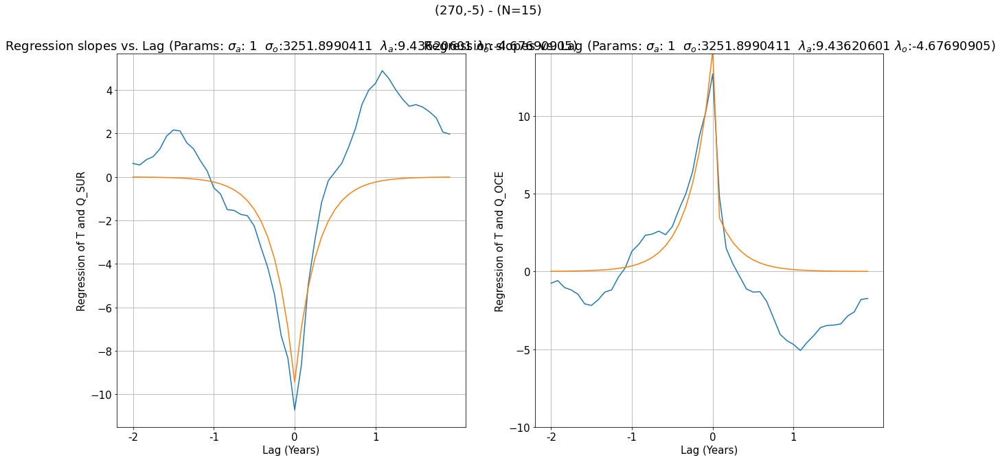

In [51]:
# Using automatic curve fit
plt.rcParams['figure.figsize'] = [20, 10]
fig, (ax,ax2) = plt.subplots(1,2)

font = {'size'   : 15,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

# Atmosphere
ax.plot(ct_canesm[1], ct_canesm[0])
ax.plot(ct_canesm[1], ct_atm)
ax.set_xticks(np.arange(-12*2,12*2,12), np.arange(-2,2,1))
#ax.set_ylim(-10,14)
ax.set_xlabel('Lag (Years)')
ax.set_ylabel('Regression of T and Q_SUR')
ax.set_title('Regression slopes vs. Lag (Params: ' + r'$\sigma_a$: ' + str(params['sigma_a']) + r'  $\sigma_o$:' +
                                              str(params['sigma_o']) + r'  $\lambda_a$:' + str(params['lambda_a']) 
                                                 + r' $\lambda_o$:' + str(params['lambda_o']) + ')')
ax.grid()

# Ocean
ax2.plot(oceanequator[1], oceanequator[0])
ax2.plot(oceanequator[1], ct_oce)
ax2.set_xticks(np.arange(-12*2,12*2,12), np.arange(-2,2,1))
ax2.set_ylim(-10,14)
ax2.set_xlabel('Lag (Years)')
ax2.set_ylabel('Regression of T and Q_OCE')
ax2.set_title('Regression slopes vs. Lag (Params: ' + r'$\sigma_a$: ' + str(params['sigma_a']) + r'  $\sigma_o$:' +
                                              str(params['sigma_o']) + r'  $\lambda_a$:' + str(params['lambda_a']) 
                                                 + r' $\lambda_o$:' + str(params['lambda_o']) + ')')
ax2.grid()

plt.suptitle('(270,-5) - (N=15)')

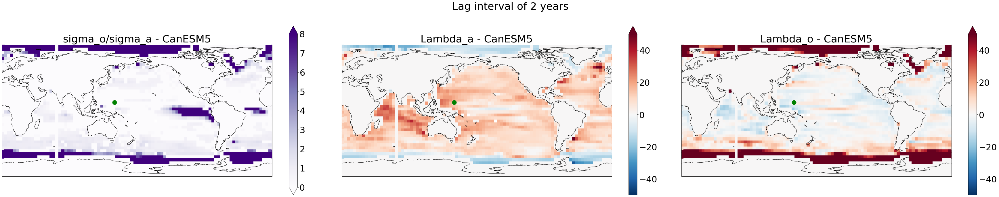

In [55]:
fig = plt.figure(figsize=(50, 10))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

lon=150
lat=10

ax1 = fig.add_subplot(131, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_4x4.sel(param='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=8, cmap='Purples')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('sigma_o/sigma_a - CanESM5')

ax2 = fig.add_subplot(132, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_4x4.sel(param='lambda_a').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-50, vmax=50, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a - CanESM5')

ax3 = fig.add_subplot(133, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_canesm_4x4.sel(param='lambda_o').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-50, vmax=50, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o - CanESM5')

plt.suptitle('Lag interval of 2 years')
fig.tight_layout()

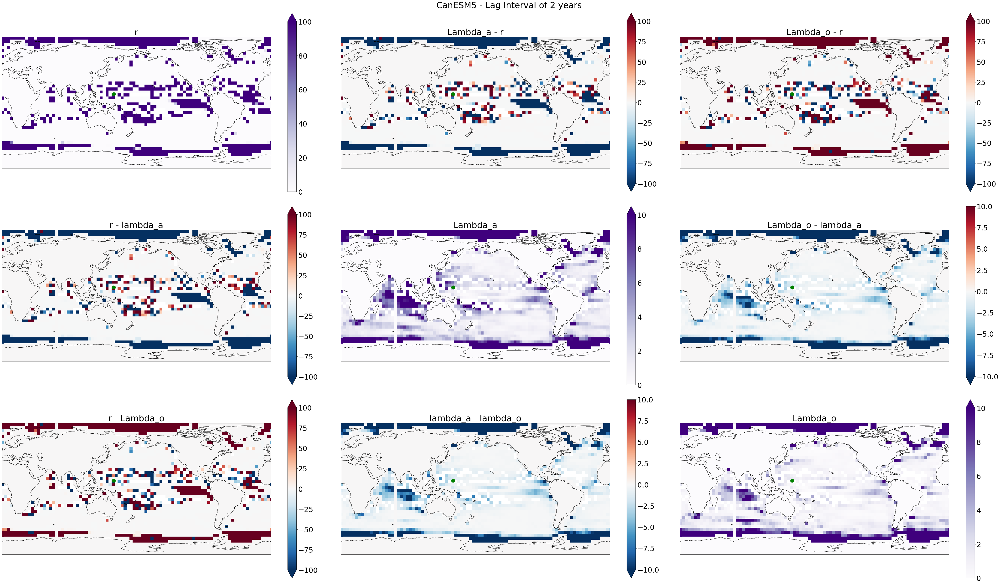

In [38]:
# 4x4 - 2/7

fig = plt.figure(figsize=(60, 35))

font = {'size'   : 30,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

ax1 = fig.add_subplot(331, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='r').sel(covparam2='r').plot(ax=ax1, transform=ccrs.PlateCarree(), vmin=0, vmax=100,
                                                             cmap='Purples')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax1.coastlines(color='black', linewidth=1)
ax1.set_title('r')

ax2 = fig.add_subplot(332, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_a').sel(covparam2='r').plot(ax=ax2, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax2.coastlines(color='black', linewidth=1)
ax2.set_title('Lambda_a - r')

ax3 = fig.add_subplot(333, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_o').sel(covparam2='r').plot(ax=ax3, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax3.coastlines(color='black', linewidth=1)
ax3.set_title('Lambda_o - r')

ax4 = fig.add_subplot(334, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='r').sel(covparam2='lambda_a').plot(ax=ax4, transform=ccrs.PlateCarree(), vmin=-100,
                                                                        vmax=100, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax4.coastlines(color='black', linewidth=1)
ax4.set_title('r - lambda_a')

ax5 = fig.add_subplot(335, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_a').sel(covparam2='lambda_a').plot(ax=ax5, transform=ccrs.PlateCarree(),
                                                                               vmin=0, vmax=10, cmap='Purples')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax5.coastlines(color='black', linewidth=1)
ax5.set_title('Lambda_a')

ax6 = fig.add_subplot(336, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_o').sel(covparam2='lambda_a').plot(ax=ax6, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax6.coastlines(color='black', linewidth=1)
ax6.set_title('Lambda_o - lambda_a')

ax7 = fig.add_subplot(337, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='r').sel(covparam2='lambda_o').plot(ax=ax7, transform=ccrs.PlateCarree(),
                                                                        vmin=-100, vmax=100, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax7.coastlines(color='black', linewidth=1)
ax7.set_title('r - Lambda_o')

ax8 = fig.add_subplot(338, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_a').sel(covparam2='lambda_o').plot(ax=ax8, transform=ccrs.PlateCarree(),
                                                                           vmin=-10, vmax=10, cmap='RdBu_r')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax8.coastlines(color='black', linewidth=1)
ax8.set_title('lambda_a - lambda_o')

ax9 = fig.add_subplot(339, projection=ccrs.PlateCarree(central_longitude=180))
coeffs_cov_canesm_4x4.sel(covparam1='lambda_o').sel(covparam2='lambda_o').plot(ax=ax9, transform=ccrs.PlateCarree(),
                                                                           vmin=0, vmax=10, cmap='Purples')
plt.plot(lon,lat, marker='o', color='g', markersize=15, transform=ccrs.PlateCarree())
ax9.coastlines(color='black', linewidth=1)
ax9.set_title('Lambda_o')

plt.suptitle('CanESM5 - Lag interval of 2 years')
fig.tight_layout()

In [39]:
warmpool = coeffs_canesm_4x4.sel(lon=150, method='nearest').sel(lat=10, method='nearest')

In [40]:
warmpool

<xarray.DataArray (param: 3)>
array([-7.17625443e-06,  1.12479640e+01,  1.09040515e+00])
Coordinates:
    lon      int64 149
    lat      int64 9
  * param    (param) object 'r' 'lambda_a' 'lambda_o'

In [52]:
params = {}
params['lambda_a'] = 1.12479640e01
params['lambda_o'] = 1.09040515
params['sigma_a'] = 1
params['sigma_o'] = -7.17625443e-06
years = 125
lagint = 12*2

density = 1026 #Water density - kg/m3
c_p = 3850 #Specific heat of salt water - J/kgC
seconds = 30*24*60*60 #Time in a week - seconds
mlotst_equator = mlotst.sel(lat=10,method='nearest').sel(lon=150,method='nearest'
                                                        ).sel(name='CanESM5').mean('time').values

wp_atm, wp_oce = analytical(params, lagint)

In [46]:
wp_canesm_a = lagregress(dataarray_Qs_cont.sel(lat=10,method='nearest').sel(lon=150,method='nearest').sel(name='CanESM5'), 
                         dataarray_SST_cont.sel(lat=10,method='nearest').sel(lon=150,method='nearest').sel(name='CanESM5'),
                         lagint = 12*2)

wp_canesm_o = lagregress(dataarray_Qo_cont.sel(lat=10,method='nearest').sel(lon=150,method='nearest').sel(name='CanESM5'), 
                         dataarray_SST_cont.sel(lat=10,method='nearest').sel(lon=150,method='nearest').sel(name='CanESM5'),
                         lagint = 12*2)

Text(0.5, 0.98, '(150,10) - (N=15)')

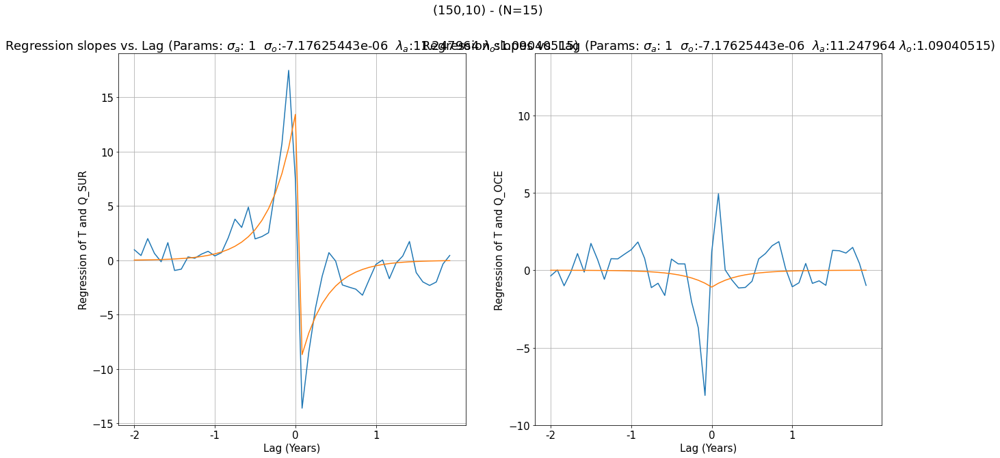

In [53]:
# Using automatic curve fit
plt.rcParams['figure.figsize'] = [20, 10]
fig, (ax,ax2) = plt.subplots(1,2)

font = {'size'   : 15,
        'weight' : 'normal'}

matplotlib.rc('font', **font)

# Atmosphere
ax.plot(wp_canesm_a[1], wp_canesm_a[0])
ax.plot(wp_canesm_a[1], wp_atm)
ax.set_xticks(np.arange(-12*2,12*2,12), np.arange(-2,2,1))
#ax.set_ylim(-10,14)
ax.set_xlabel('Lag (Years)')
ax.set_ylabel('Regression of T and Q_SUR')
ax.set_title('Regression slopes vs. Lag (Params: ' + r'$\sigma_a$: ' + str(params['sigma_a']) + r'  $\sigma_o$:' +
                                              str(params['sigma_o']) + r'  $\lambda_a$:' + str(params['lambda_a']) 
                                                 + r' $\lambda_o$:' + str(params['lambda_o']) + ')')
ax.grid()

# Ocean
ax2.plot(wp_canesm_o[1], wp_canesm_o[0])
ax2.plot(wp_canesm_o[1], wp_oce)
ax2.set_xticks(np.arange(-12*2,12*2,12), np.arange(-2,2,1))
ax2.set_ylim(-10,14)
ax2.set_xlabel('Lag (Years)')
ax2.set_ylabel('Regression of T and Q_OCE')
ax2.set_title('Regression slopes vs. Lag (Params: ' + r'$\sigma_a$: ' + str(params['sigma_a']) + r'  $\sigma_o$:' +
                                              str(params['sigma_o']) + r'  $\lambda_a$:' + str(params['lambda_a']) 
                                                 + r' $\lambda_o$:' + str(params['lambda_o']) + ')')
ax2.grid()

plt.suptitle('(150,10) - (N=15)')